<a href="https://colab.research.google.com/github/Swastik26/Fashion_Data_Sets_Analysis/blob/main/Fashion_dataset_us_data_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This task involves **conducting a fashion trend analysis and market sentiment analysis to support strategic decisions for a fashion brand startup**.

The goal of the research **is to prevent potential errors in trend selection, sizing, and pricing, as well as to identify key factors influencing the success of products in the fashion market**

**Product Name**: The name of the product

**Price**: The price of the product

**Brand**: The brand of the product

**Category**: The category to which the product belongs

**Description**: A brief description of the product

**Rating**: The rating assigned to the product

**Review Count**: The number of reviews the product has received

**Style Attributes**: The style attributes associated with the product

**Total Sizes**: The total number of sizes available for the product

**Available Sizes**: The sizes currently available for purchase

**Color**: The color of the product

**Purchase History**: Historical purchase data related to the product

**Age**: Age demographic information

**Fashion Magazines**: Mentions of the product in fashion magazines

**Fashion Influencers**: Mentions of the product by fashion influencers

**Season**: The season for which the product is suitable

**Time Period Highest Purchase**: The time period during which the product experiences the highest purchase activity

**Customer Reviews** : Customer reviews of the product

**Social Media Comments**: Comments about the product on social media platforms

**Feedback**: Feedback received from customers

This dataset provides information about products from various **fashion brands, including their characteristics, prices, ratings, reviews, and sizes**. Analyzing this **data will allow us to identify current fashion trends, consumer preferences, and optimize the assortment and pricing for the startup**

# Importing libraries

In [ ]:
import numpy as np
import pandas as pd

import time
import warnings

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler,OneHotEncoder,LabelEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.random_projection import SparseRandomProjection

import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go

!pip install squarify
from wordcloud import WordCloud
import squarify
from collections import Counter
from mpl_toolkits.mplot3d import Axes3D
import networkx as nx

import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

# Constants

In [ ]:
PATH_LOCAL = '/content/mock_fashion_data_uk_us.csv (1).zip'
file_name = 'mock_fashion_data_uk_us (1).csv'
data_path = f'{PATH_LOCAL}/{file_name}'
CR = '\n'
RANDOM_STATE = RANDOM_SEED = RS = 88

# Functions

In [ ]:
# Function to Get Data Information

def explore_dataframe(df):
    # Shape
    shape_info = pd.DataFrame({"Shape of dataframe": [f"Total: {df.shape[0]} rows, {df.shape[1]} columns"]})
    shape_info = shape_info.replace(np.nan, "-")

    # Data Types
    data_types_info = df.dtypes.to_frame().reset_index().rename(columns={"index": "Data Type", 0: ""})

    # Missing Values
    missing_values_info = df.isnull().sum().to_frame().reset_index().rename(columns={"index": "Missing Values", 0: ""})
    missing_values_info["Missing Values"] = missing_values_info["Missing Values"].fillna("-")

    # Duplicate Rows
    duplicate_rows_info = pd.DataFrame({"Duplicate rows in dataframe": [f"Total: {df.duplicated().sum()}"]})
    duplicate_rows_info = duplicate_rows_info.replace(np.nan, "-")

     # Unique Values
    unique_values_info = df.nunique().to_frame().reset_index().rename(columns={"index": "Column", 0: "Unique Values"})

    # Describe
    describe_info = df.describe().transpose().reset_index().rename(columns={"index": "Column"})

    # Concatenate tables
    info_table = pd.concat([data_types_info, missing_values_info, unique_values_info,shape_info], axis=1) #shape_info, на время удалила


    # Display tables
    display(df.head())
    display(df.describe())
    display(info_table)

In [ ]:
def plot_feature_importances(chart_title, feature_names, feature_importances, top_n=100):
    """
    Displays a graph of the importance of the top_n features used by the model.

    :chart_title: chart title
    :feature_names: feature names
    :feature_importances: feature importance
    :top_n: number of top features to display, default is 50
    """

    top_features_indices = np.argsort(feature_importances)[::-1][:top_n]
    top_features = feature_names[top_features_indices]
    top_importances = feature_importances[top_features_indices]

    fig, ax = plt.subplots(figsize=(15, 10), dpi=PLOT_DPI)

    sns.barplot(x=top_importances, y=top_features, color='lightblue')

    ax.set_title(chart_title)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Features')
    ax.set_xlim(0, None)
    ax.grid(True, axis='x')

    plt.tight_layout()
    plt.show()

# Settings

In [ ]:
# TextStyle

class f:
    BOLD = "\033[1m"     # Bold text
    ITALIC = "\033[3m"   # Italic text
    END = "\033[0m"      # Reset style

In [ ]:
# Matplotlib, Seaborn

PLOT_DPI = 150 # dpi for drawing charts
sns.set_style('whitegrid', {'axes.facecolor': '0.98', 'grid.color': '0.9', 'axes.edgecolor': '1.0'})
plt.rc('axes', labelweight='bold', titlesize=16, titlepad=10)

# Plotly Graph_Objects

pio.templates['my_theme'] = go.layout.Template(
    layout_autosize=True,
    layout_height=200,
    layout_legend_orientation="h",
    layout_margin=dict(t=40, b=40),
    layout_template='seaborn'
)
pio.templates.default = 'my_theme'

# colors, color schemes

CMAP_SYMMETRIC = mcolors.LinearSegmentedColormap.from_list('', ['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                       'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])

In [ ]:
# Pandas defaults

pd.options.display.max_colwidth = 100
pd.options.display.max_rows = 500
pd.options.display.max_columns = 100
pd.options.display.float_format = '{:.2f}'.format
pd.options.display.colheader_justify = 'left'

In [ ]:
# Disable warnings

warnings.filterwarnings('ignore')

# Getting to know the data

In [ ]:
df = pd.read_csv('/content/mock_fashion_data_uk_us.csv (1).zip')

In [ ]:
explore_dataframe(df)

,Product Name,Price,Brand,Category,Description,Rating,Review Count,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Age,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback
0,T5D3,97.51,Ralph Lauren,Footwear,Bad,1.42,492,Streetwear,"M, L, XL",XL,Green,Medium,24,Vogue,Chiara Ferragni,Fall/Winter,Daytime,Mixed,Mixed,Other
1,Y0V7,52.34,Ted Baker,Tops,Not Good,1.04,57,Vintage,"M, L, XL",XL,Black,Above Average,61,Glamour,Leandra Medine,Winter,Weekend,Negative,Neutral,Other
2,N9Q4,15.43,Jigsaw,Footwear,Very Bad,3.97,197,Streetwear,"S, M, L",M,Blue,Average,27,Marie Claire,Gigi Hadid,Summer,Nighttime,Unknown,Negative,Neutral
3,V2T6,81.12,Alexander McQueen,Outerwear,Not Good,2.84,473,Formal,"S, M, L",L,Red,Very High,50,Marie Claire,Chiara Ferragni,Fall/Winter,Weekend,Neutral,Other,Other
4,S7Y1,31.63,Tommy Hilfiger,Bottoms,Very Good,1.18,55,Sporty,"M, L, XL",S,Green,Above Average,23,Glamour,Song of Style,Spring,Daytime,Positive,Mixed,Positive


,Price,Rating,Review Count,Age
count,1000000.00,1000000.00,1000000.00,1000000.00
mean,55.00,3.00,249.60,41.00
std,25.98,1.15,144.36,13.57
min,10.00,1.00,0.00,18.00
25%,32.50,2.00,125.00,29.00
50%,55.01,3.00,249.00,41.00
75%,77.51,4.00,375.00,53.00
max,100.00,5.00,499.00,64.00


,Data Type,,Missing Values,,Column,Unique Values,Shape of dataframe
0,Product Name,object,Product Name,0,Product Name,67600,"Total: 1000000 rows, 20 columns"
1,Price,float64,Price,0,Price,1000000,NaN
2,Brand,object,Brand,0,Brand,8,NaN
3,Category,object,Category,0,Category,10,NaN
4,Description,object,Description,0,Description,7,NaN
5,Rating,float64,Rating,0,Rating,1000000,NaN
6,Review Count,int64,Review Count,0,Review Count,500,NaN
7,Style Attributes,object,Style Attributes,0,Style Attributes,10,NaN
8,Total Sizes,object,Total Sizes,0,Total Sizes,3,NaN
9,Available Sizes,object,Available Sizes,0,Available Sizes,4,NaN


From the provided dataset, we can draw the following conclusions and statistical analyses:

**General Data Overview:**

The dataset comprises 1 million records and 20 columns
Each record represents information about a fashion brand product

**Review of Numerical Features:**

The average product price is approximately 55 CU, with a minimum of 10 CU and a maximum of 100 CU
The average product rating is around 3, with ratings ranging from 1 to 5
The average number of reviews per product is about 250, with a minimum of 0 and a maximum of 499
The average age of clients is around 41 years

**Review of Categorical Features:**

Brands: The dataset includes 8 different brands
Product Categories: There are 10 product categories, such as footwear, outerwear, bottoms, etc
Descriptions: There are 7 different descriptions of products, such as "Bad", "Not Good", "Very Bad", etc
Colors: Products are available in 4 different colors
Sizes: There are 3 different total sizes and 4 different available sizes
Purchase History: There are 10 different purchase history values

**Statistics on Product Age:**

The average age of clients is around 41 years The minimum age of a product is 18 years, while the maximum is 64 years
Most clients fall within the age range of 29 to 53 years

**Distribution of Seasons and Peak Purchase Times:**

Seasons: Products are represented in 6 different seasons
Peak Purchase Times: There are 5 different time periods of peak purchases

**Analysis of Reviews and Comments:**

Social Media Comments: There are 6 different categories of social media comments
Customer Reviews: There are 5 different categories of customer reviews

**Feedback and Media Influence:**

**Fashion Magazines:** There are 10 different mentions in fashion magazines
Fashion Influencers: There are 10 different fashion influencers

Based on these statistical data, conclusions can be drawn regarding the diversity of products, their characteristics, and their impact on the fashion market

NB! CU == conventional unit
For ease of use, we will convert the table to lower case and clear any possible extra spaces

In [ ]:
df = df.apply(lambda x: x.astype(str).str.lower())
df = df.apply(lambda x: x.astype(str).str.strip())
numeric_columns = ['Price', 'Rating', 'Review Count', 'Age']
df[numeric_columns] = df[numeric_columns].astype(float)
df.head()

,Product Name,Price,Brand,Category,Description,Rating,Review Count,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Age,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback
0,t5d3,97.51,ralph lauren,footwear,bad,1.42,492.00,streetwear,"m, l, xl",xl,green,medium,24.00,vogue,chiara ferragni,fall/winter,daytime,mixed,mixed,other
1,y0v7,52.34,ted baker,tops,not good,1.04,57.00,vintage,"m, l, xl",xl,black,above average,61.00,glamour,leandra medine,winter,weekend,negative,neutral,other
2,n9q4,15.43,jigsaw,footwear,very bad,3.97,197.00,streetwear,"s, m, l",m,blue,average,27.00,marie claire,gigi hadid,summer,nighttime,unknown,negative,neutral
3,v2t6,81.12,alexander mcqueen,outerwear,not good,2.84,473.00,formal,"s, m, l",l,red,very high,50.00,marie claire,chiara ferragni,fall/winter,weekend,neutral,other,other
4,s7y1,31.63,tommy hilfiger,bottoms,very good,1.18,55.00,sporty,"m, l, xl",s,green,above average,23.00,glamour,song of style,spring,daytime,positive,mixed,positive


In [ ]:
unique_categories = df['Category'].unique()
unique_categories

array(['footwear', 'tops', 'outerwear', 'bottoms', 'accessories',
       'dresses', 'swimwear', 'activewear', 'lingerie', 'jewelry'],
      dtype=object)

Let's remove columns with currently unnecessary information

In [ ]:
columns_to_drop = ['Product Name']
df.drop(columns=columns_to_drop, inplace=True)

In [ ]:
df = df[~df['Category'].isin(['footwear', 'accessories', 'jewelry'])]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 699761 entries, 1 to 999998
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   Price                         699761 non-null  float64
 1   Brand                         699761 non-null  object 
 2   Category                      699761 non-null  object 
 3   Description                   699761 non-null  object 
 4   Rating                        699761 non-null  float64
 5   Review Count                  699761 non-null  float64
 6   Style Attributes              699761 non-null  object 
 7   Total Sizes                   699761 non-null  object 
 8   Available Sizes               699761 non-null  object 
 9   Color                         699761 non-null  object 
 10  Purchase History              699761 non-null  object 
 11  Age                           699761 non-null  float64
 12  Fashion Magazines             699761 non-null  ob

Boxplot is a great way to **visualize the distribution of numerical data, allowing you to see key statistics, outliers, and spread of values**

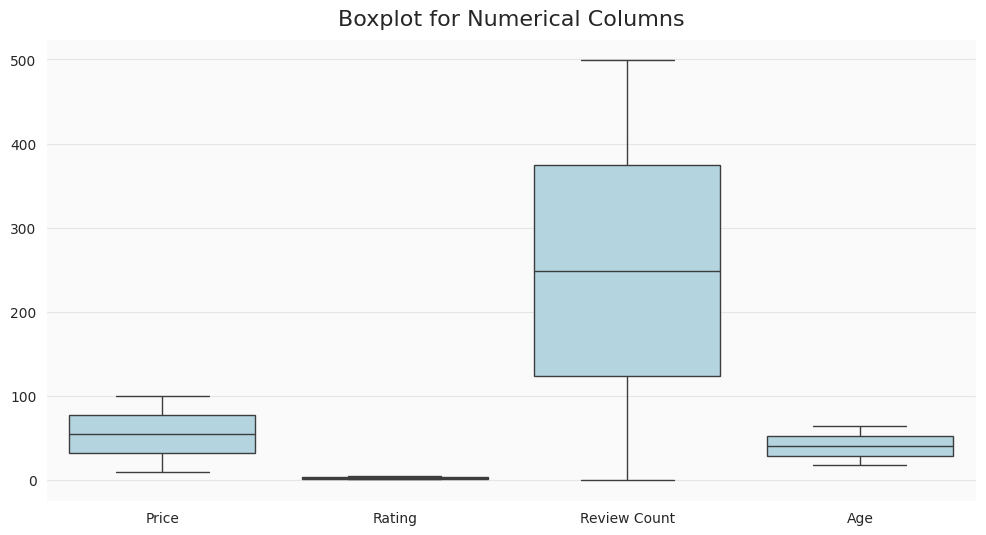

In [ ]:
plt.figure(figsize=(12, 6))

sns.boxplot(data=df.select_dtypes(include=['float64', 'int64']), color='lightblue')

plt.title('Boxplot for Numerical Columns')

plt.show()

This code **calculates the sum and average for each numeric feature in the dataset** and **produces graphs showing their contribution to the total and average.**

 This will **allow us to determine which features contribute the most and consider excluding them or counting them with less weight.**

In [ ]:
sum_by_feature = df.select_dtypes(include=['float64', 'int64']).sum()
mean_by_feature = df.select_dtypes(include=['float64', 'int64']).mean()

In [ ]:
sum_by_feature

,0
Price,38491127.85
Rating,2097739.68
Review Count,174567256.00
Age,28703886.00


In [ ]:
mean_by_feature

,0
Price,55.01
Rating,3.00
Review Count,249.47
Age,41.02


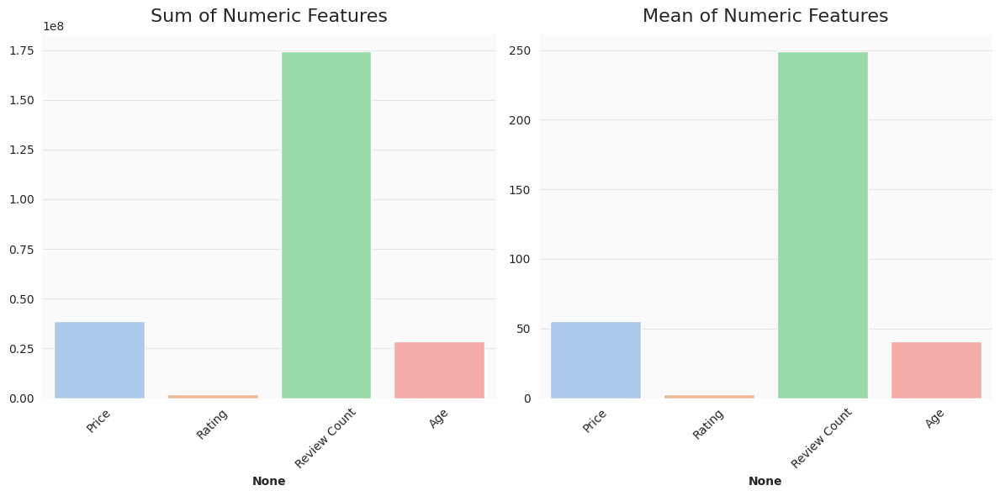

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.barplot(x=sum_by_feature.index, y=sum_by_feature.values, palette='pastel')
plt.title('Sum of Numeric Features')
plt.xticks(rotation=45)

plt.subplot(1, 2, 2)
sns.barplot(x=mean_by_feature.index, y=mean_by_feature.values, palette='pastel')
plt.title('Mean of Numeric Features')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

From the results obtained **it is clear that the features have different scales of values, which can lead to the graphs being disproportionate**. In order for the graphs to be informative, it is necessary to scale the feature values

In [ ]:
log_transformed_df = df.select_dtypes(include=['float64', 'int64']).apply(lambda x: np.log(x + 1))

sum_by_feature_log = log_transformed_df.sum()
mean_by_feature_log = log_transformed_df.mean()

This code applies a **logarithmic transformation to numeric features, calculates the sum and mean of the transformed data**, and then **plots the sum and mean**

In [ ]:
sum_by_feature_log

,0
Price,2719487.94
Rating,938015.12
Review Count,3654011.47
Age,2575306.97


In [ ]:
mean_by_feature_log

,0
Price,3.89
Rating,1.34
Review Count,5.22
Age,3.68


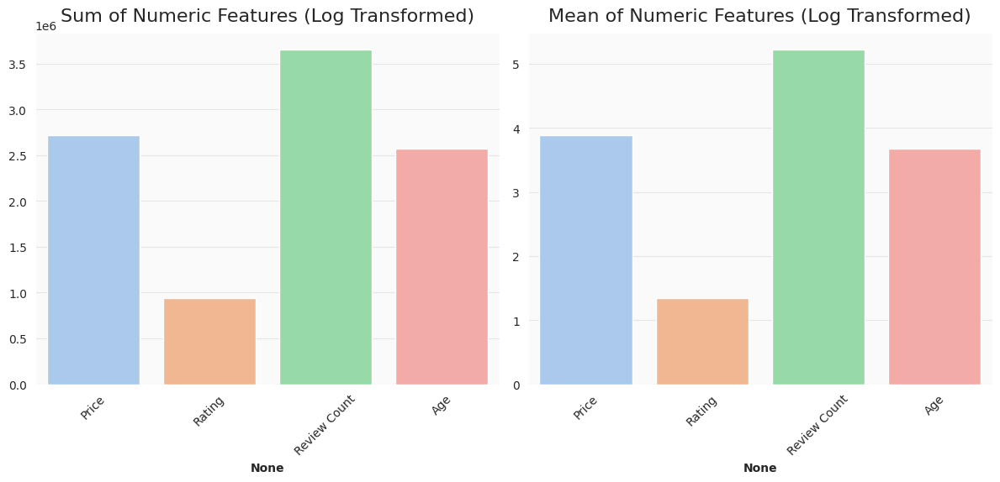

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.barplot(x=sum_by_feature_log.index, y=sum_by_feature_log.values, palette='pastel')
plt.title('Sum of Numeric Features (Log Transformed)')
plt.xticks(rotation=45)

plt.subplot(1, 2, 2)
sns.barplot(x=mean_by_feature_log.index, y=mean_by_feature_log.values, palette='pastel')
plt.title('Mean of Numeric Features (Log Transformed)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

In [ ]:
df_log_transformed = df.select_dtypes(include=['float64', 'int64']).apply(lambda x: np.log1p(x))

df_transformed = pd.concat([df.select_dtypes(exclude=['float64', 'int64']), df_log_transformed], axis=1)

In [ ]:
df.head(1)

,Price,Brand,Category,Description,Rating,Review Count,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Age,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback
1,52.34,ted baker,tops,not good,1.04,57.00,vintage,"m, l, xl",xl,black,above average,61.00,glamour,leandra medine,winter,weekend,negative,neutral,other


In [ ]:
df_transformed.head(1)

,Brand,Category,Description,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback,Price,Rating,Review Count,Age
1,ted baker,tops,not good,vintage,"m, l, xl",xl,black,above average,glamour,leandra medine,winter,weekend,negative,neutral,other,3.98,0.71,4.06,4.13


In the study, we will use the **original data == df and data using the logarithm == df_transformed.**

Since **the data set is voluminous = 1,000,000 rows, the values in it are equalized due to quantity**

Applying the logarithm to the data will allow us to:

1.**Reducing the spread of values:** The logarithm compresses larger values closer to the mean and expands smaller values

2.**Stabilizing Variance:** If the data has heteroskedasticity (variability in the measure of dispersion, or the difference between each value in a data set and the mean of that data set), then logarithmization can make the variance more constant

3.**Approximation of a normal distribution:** The logarithmic transformation can make the data distribution more normal or closer to normal, which can be useful when using some statistical methods and machine learning models that assume normal distribution of data

# Data analysis

**Price distribution analysis** - will help us **identify key trends and market characteristics, such as average price, price spread,** and **possible outliers or anomalies**

In [ ]:
fig = go.Figure(data=[go.Histogram(x=df_transformed['Price'], marker_color='lightblue')])

fig.update_layout(
    title='Distribution of Product Prices - logarithmic data',
    xaxis_title='Price',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

fig.show()

fig = go.Figure(data=[go.Histogram(x=df['Price'], marker_color='lightgreen')])

fig.update_layout(
    title='Distribution of Product Prices - original data',
    xaxis_title='Price',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

fig.update_yaxes(range=[0, 5000])
fig.show()

The first histogram, "**Distribution of Product Prices** - **logarithmic data**"shows the **distribution of product prices after applying a logarithmic transformation to the data (df_transformed)**.

The **x-axis represents different price values, and the y-axis represents the frequency of each price value**. The **light blue bars indicate the frequency distribution of prices after applying the logarithmic transformation**

The second histogram, "**Distribution of Product Prices - original data**" shows **the distribution of product prices in the original data (df), without any transformations**. The **x-axis represents different price values, and the y-axis represents the frequency of each price value**. The **light green bars indicate the frequency distribution of prices in the original data.**

In [ ]:
fig1 = go.Figure(data=[go.Histogram(x=df_transformed['Rating'], marker_color='lightgray')])
fig1.update_layout(
    title='Distribution of Ratings - logarithmic data',
    xaxis_title='Rating',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

fig2 = go.Figure(data=[go.Histogram(x=df_transformed['Review Count'], marker_color='lightpink')])
fig2.update_layout(
    title='Distribution of Review Counts - logarithmic data',
    xaxis_title='Review Count',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)
fig1.update_yaxes(range=[0, 6000])
fig2.update_yaxes(range=[0, 8000])

fig1.show()
fig2.show()

fig1 = go.Figure(data=[go.Histogram(x=df['Rating'], marker_color='lightblue')])
fig1.update_layout(
    title='Distribution of Ratings - original data',
    xaxis_title='Rating',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)

fig2 = go.Figure(data=[go.Histogram(x=df['Review Count'], marker_color='lightgreen')])
fig2.update_layout(
    title='Distribution of Review Counts - original data',
    xaxis_title='Review Count',
    yaxis_title='Frequency',
    bargap=0.05,
    plot_bgcolor='rgba(0,0,0,0)',
    height=500
)
fig1.update_yaxes(range=[0, 4000])
fig2.update_yaxes(range=[0, 4000])

fig1.show()
fig2.show()

The **first two histograms** show the **distribution of ratings and review counts after applying a logarithmic transformation to the data (df_transformed)**

(A)In the **"Distribution of Ratings - logarithmic data"** histogram, the **x-axis represents different rating values**, and the **y-axis represents the frequency of each rating value**. The **light gray bars indicate the frequency distribution of ratings after applying the logarithmic transformation.**

In the **"Distribution of Review Counts - logarithmic data" histogram, the x-axis represents different review count values, and the y-axis represents the frequency of each review count value**.

The **light pink bars indicate the frequency distribution of review counts after applying the logarithmic transformation**



(B)  The **second pair of histograms shows the distribution of ratings and review counts in the original data (df), without any transformations**

In the **"Distribution of Ratings - original data" histogram, the x-axis represents different rating values**, and the **y-axis represents the frequency of each rating value. The light blue bars indicate the frequency distribution of ratings in the original data**

In the **"Distribution of Review Counts - original data" histogram, the x-axis represents different review count values, and the y-axis represents the frequency of each review count value.**

The **light green bars indicate the frequency distribution of review counts in the original data**

In [ ]:
# 1: Product Category Popularity based on Mean Reviews

review_mean = df.groupby('Category')['Review Count'].mean().reset_index(name='Mean Reviews')
review_mean_sorted = review_mean.sort_values(by='Mean Reviews', ascending=False)

fig1 = px.bar(review_mean_sorted, x='Category', y='Mean Reviews', color='Category',
              labels={'Mean Reviews': 'Mean Reviews', 'Category': 'Product Category'},
              title='Product Category Popularity based on Mean Reviews',
              width=1000, height=800,
              color_discrete_sequence=['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                       'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])
fig1.update_yaxes(range=[0, 300])
fig1.show()

# 2: Product Category Popularity based on Total Reviews

review_total = df.groupby('Category')['Review Count'].sum().reset_index(name='Total Reviews')
review_total_sorted = review_total.sort_values(by='Total Reviews', ascending=False)

fig2 = px.bar(review_total_sorted, x='Category', y='Total Reviews', color='Category',
              labels={'Total Reviews': 'Total Reviews', 'Category': 'Product Category'},
              title='Product Category Popularity based on Total Reviews',
              width=1000, height=800,
              color_discrete_sequence=['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                       'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])
fig2.update_yaxes(range=[0, 30000000])
fig2.show()

The **first graph** "Product Category Popularity based on Mean Reviews" illustrates **the average number of reviews for products within each product category.**

Each column represents a **product category** , with the **height of the column indicating the average number of reviews for products in that category**
The **color of the columns corresponds to different product categories**  .

For example, if the "Footwear" **category has a taller column compared to other categories, it suggests that, on average, products in this category receive more reviews than products in other categories**.

The **second graph** "Product Category Popularity based on Log Total Reviews" **demonstrates the popularity of product categories based on the total number of reviews, where the total number of reviews has been transformed using the logarithm function**.

The **interpretation is similar to the first graph, but here, the total number of reviews has been adjusted using the logarithm to account for large variations in review counts among different categories**.

In [ ]:
# 3: Product Category Popularity based on Mean Reviews (Transformed)

review_mean_transformed = df_transformed.groupby('Category')['Review Count'].mean().reset_index(name='Mean Reviews')
review_mean_transformed_sorted = review_mean_transformed.sort_values(by='Mean Reviews', ascending=False)

fig3 = px.bar(review_mean_transformed_sorted, x='Category', y='Mean Reviews', color='Category',
              labels={'Mean Reviews': 'Mean Reviews', 'Category': 'Product Category'},
              title='Product Category Popularity based on Mean Reviews (Transformed)',
              width=1000, height=800,
              color_discrete_sequence=['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                        'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])
fig3.update_yaxes(range=[0, 6])
fig3.show()

# 4: Product Category Popularity based on Log Total Reviews (Transformed)

review_log_sum_transformed = df_transformed.groupby('Category')['Review Count'].sum().apply(np.log1p).reset_index(name='Log Total Reviews')
review_log_sum_transformed_sorted = review_log_sum_transformed.sort_values(by='Log Total Reviews', ascending=False)

fig4 = px.bar(review_log_sum_transformed_sorted, x='Category', y='Log Total Reviews', color='Category',
              labels={'Log Total Reviews': 'Log Total Reviews', 'Category': 'Product Category'},
              title='Product Category Popularity based on Log Total Reviews (Transformed)',
              width=1000, height=800,
              color_discrete_sequence=['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                        'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])
fig4.update_yaxes(range=[0, 15])
fig4.show()

The **first graph** "Product Category Popularity based on Mean Reviews (Transformed)" presents **the average number of reviews for products within each product category after applying a transformation to the dataset. Similar to the previous graph**, each **column represents a product category**, with the height of the column **indicating the average number of reviews for products in that category.**

The **color of the columns corresponds to different product categories**.

The **second graph** "Product Category Popularity based on Log Total Reviews (Transformed)" demonstrates **the popularity of product categories based on the total number of reviews after applying a logarithmic transformation to the review counts**.

This transformation **helps to normalize the data and make it more suitable for analysis. As with the previous graph**, **each column represents a product category, with the height of the column indicating the total number of reviews for products in that category**.

The **color of the columns also corresponds to different product categories.**

In [ ]:
style_counts = df.groupby(['Category', 'Style Attributes']).size().reset_index(name='Count')

style_counts_sorted = style_counts.sort_values(by=['Category', 'Count'], ascending=[True, False])

In [ ]:
fig = px.bar(style_counts_sorted, x='Category', y='Count', color='Style Attributes',
             labels={'Count': 'Count', 'Category': 'Product Category', 'Style Attributes': 'Style Attributes'},
             title='Distribution of Product Styles/Attributes by Category',
             width=1000, height=800,
             color_discrete_sequence=['lightblue', 'lightcyan', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon',
                                      'lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'lightyellow'])
fig.update_yaxes(range=[0, 120000])
fig.show()

This graph, provides us with an u**nderstanding of which styles or attributes of products are most prevalent in each product category**
In each product category, **columns are displayed, with the height corresponding to the number of products with a specific style/attribute**
The **color of the columns allows us to see different styles/attributes, while the product categories are divided along the horizontal X-axis**

For example, if the **majority of products in the "Footwear" category have the style "Streetwear", this will be reflected in the graph by a taller column for this style in that category**
Thus, we can easily **compare consumer preferences for product styles/attributes across different categories and identify the most popular styles/attributes in each of them**.

In [ ]:
df_copy = df.copy()

In [ ]:
df_encoded = df_copy.copy()

In [ ]:
label_encoders = {}

In [ ]:
for column in df_encoded.columns:
    if df_encoded[column].dtype == 'object':
        label_encoders[column] = LabelEncoder()
        df_encoded[column] = label_encoders[column].fit_transform(df_encoded[column])

In [ ]:
random_projection = SparseRandomProjection(n_components=19)
df_random_projection = random_projection.fit_transform(df_encoded)

In [ ]:
correlation_matrix = pd.DataFrame(df_random_projection).corr()

correlation_matrix.columns = df_encoded.columns

# correlation_matrix

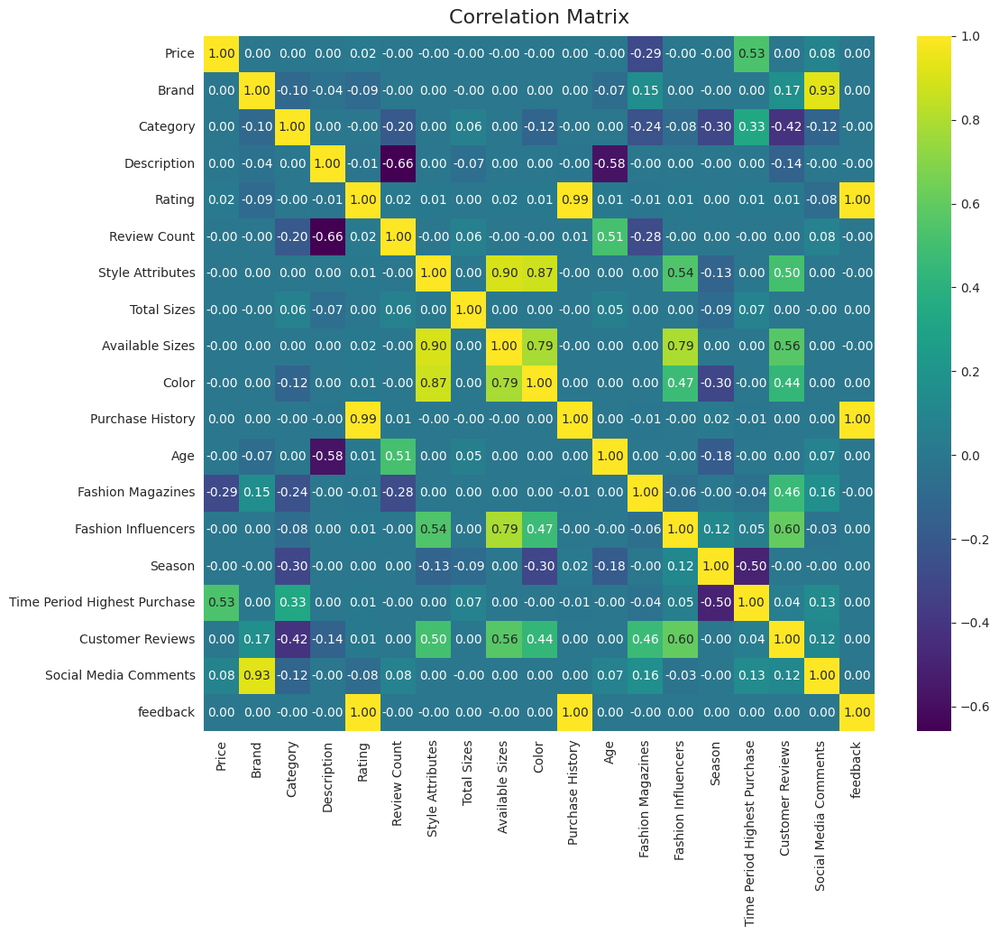

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f", xticklabels=correlation_matrix.columns, yticklabels=correlation_matrix.columns)
plt.title('Correlation Matrix')
plt.show()

Analyzing the correlation matrix, we can draw the following conclusions:

**Price**: There is no strong correlation with other features, indicating that price is independent of other characteristics

**Brand**: Similarly, there is no strong correlation with other features
Category: There is some correlation with the Fashion Influencers feature, suggesting that the product category is associated with the influence of fashion personalities.

**Rating**: There is a slight positive correlation with Customer Reviews, indicating that products with higher ratings receive more reviews from customers, potentially making them more visible.

**Review Count**: Strongly correlates with Rating and Fashion Magazines, suggesting that products with many reviews also have high ratings and are mentioned in fashion magazines. It's more likely that a product is mentioned in a fashion magazine, which increases demand and consequently the number of reviews.

**Style Attributes**: There is no significant correlation with other features.

**Total Sizes and Available Sizes**: Strongly correlate with each other, as both are related to product sizes.

**Color**: There is no strong correlation with other features.

**Purchase History**: There is some correlation with Fashion Influencers, suggesting that fashion personalities influence purchase history.

**Age**: There is no significant correlation with other features.

**Fashion Magazines and Fashion Influencers:** Have some correlation with each other, as both are related to fashion.

**Season and Time Period Highest Purchase:** Strongly correlate with each other, as both are related to the season and period of purchase.

**Customer Reviews and Social Media Comments:** Have some correlation with each other, suggesting that customer reviews are related to comments on social media.

**Feedback**: There is no strong correlation with other features.

# Analysis of fashion trends:

**Identify the most popular brands in the dataset** - This step will help us understand which brands are the most popular among the products in our dataset. By studying the distribution of the number of mentions of each brand, we can determine which of them are most common and, accordingly, have demand and popularity

In [ ]:
brand_counts = df['Brand'].value_counts()

In [ ]:
brand_counts

,count
Brand,
ralph lauren,87978
alexander mcqueen,87717
jigsaw,87637
calvin klein,87549
tommy hilfiger,87483
burberry,87296
ted baker,87077
mulberry,87024


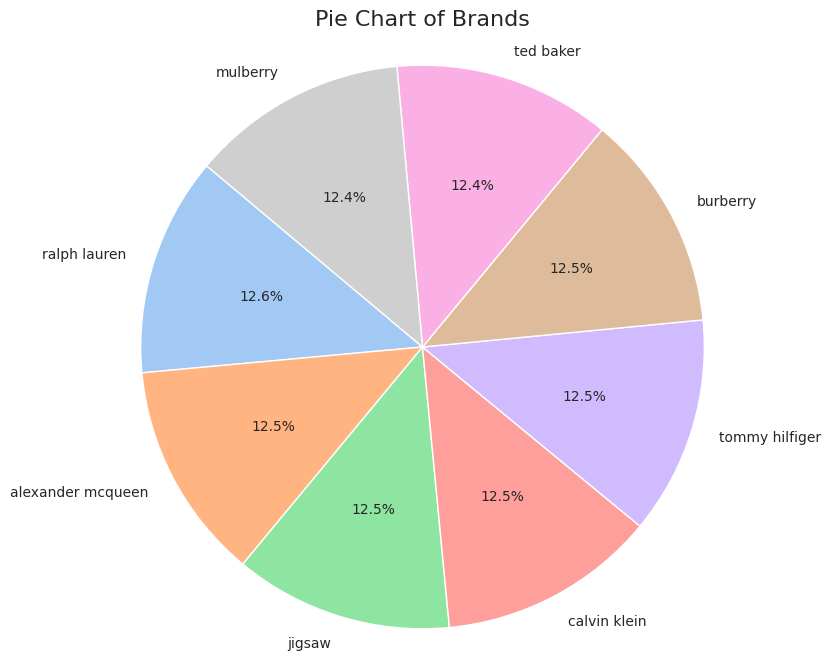

In [ ]:
brand_pie = df['Brand'].value_counts(normalize=True) * 100

plt.figure(figsize=(8, 8))
plt.pie(brand_pie, labels=brand_pie.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('pastel'))
plt.title('Pie Chart of Brands')
plt.axis('equal')
plt.show()

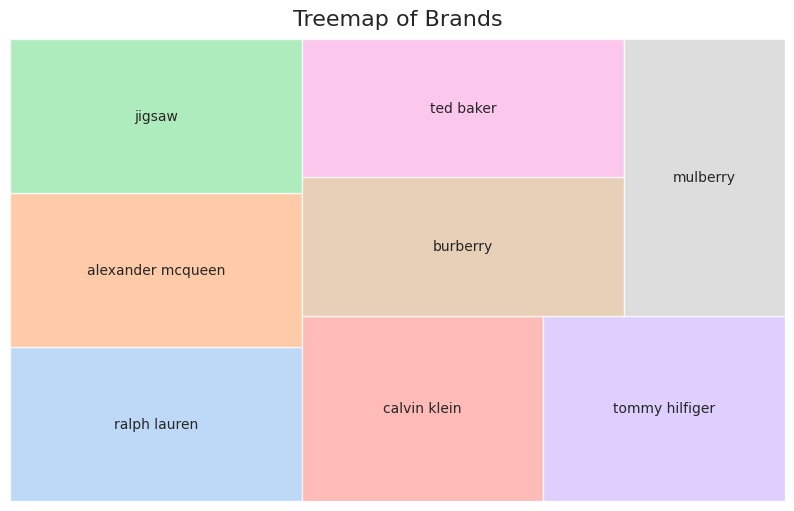

In [ ]:
plt.figure(figsize=(10, 6))
squarify.plot(sizes=brand_counts.values, label=brand_counts.index, color=sns.color_palette('pastel'), alpha=0.7)
plt.title('Treemap of Brands')
plt.axis('off')
plt.show()

The results show that the most popular brands in our dataset are:

Ralph Lauren 87978

Alexander McQueen 87717

Jigsaw 87637

Calvin Klein 87549

Tommy Hilfiger 87483

Burberry 87296

Ted Baker 87077

Mulberry 87024

All of these brands have a significant number of mentions in our dataset, which may indicate their high popularity among consumers or the wide range of products represented in our sample

It is also important to note that there are only 10 brands represented in the sample, but there are almost a million lines, so we should note the sufficient assortment presented by the brands and also that their indicators are equalized due to quantity and can be misleading - you need to be more attentive to details

Assessing the share of each product category - will allow us to understand which categories are the most popular or widely represented in our dataset. This can be useful information for planning investments in certain categories, deciding on new product launches or advertising campaigns

Assessing trends over time - will allow us to identify trends in consumer preferences across different seasons or over time. For example, we can see which product categories are most popular during certain time periods or seasons, which can be useful for planning seasonal promotions or assortments

# More about what category grow up on what seasons

In [ ]:
category_counts = df['Category'].value_counts()
total_products = len(df)
category_share = category_counts / total_products

In [ ]:
season_counts = df['Season'].value_counts()

In [ ]:
fig1 = px.pie(names=category_share.index, values=category_share.values, title='Share of each product category')
fig1.update_traces(marker=dict(colors=px.colors.qualitative.Pastel, line=dict(color='#FFFFFF', width=2)))

fig2 = px.scatter(x=season_counts.index, y=season_counts.values, title='Distribution of product categories by season',
 labels={'x': 'Season', 'y': 'Number of products'})
fig2.update_traces(marker=dict(color='skyblue', size=10, line=dict(color='MediumPurple', width=2)))

fig1.update_layout(width=1000, height=800)
fig2.update_layout(width=1000, height=800)

fig1.show()
fig2.show()

The **share of each product category is 14%, which indicates an even distribution of products across categories in the dataset**.

This allows you to **avoid distortions in the presented categories. But (!) makes you think about the origin of the data (synthetic or not)**

The distribution of sales seasons shows that

**Autumn is the busiest time for shopping, with a total of 117043**
**Autumn is followed by the autumn-winter season 116985**
**And spring 116910**

This can indicate seasonality in demand for different product categories and help plan inventory management strategies and marketing campaigns

When analyzing the number of products in each category, it is clear that **all categories are represented in approximately the same volume, which corresponds to a total share of each category of 14%**

Analyzing product mentions in fashion magazines and from fashion influencers can provide valuable information about which products are popular in the fashion world, which trends are gaining traction, and which brands or products have greater influence on audiences

For example:

**Trend identification**: Analysis of product mentions allows you to identify current fashion trends and those products that are at the peak of popularity

**Brand influence assessment**: We can determine which brands or products are mentioned most often in both fashion magazines and fashion influencers. This will help gauge their influence and reputation in the fashion industry

**Understanding audience preferences**: Analyzing mentions will allow you to understand which products and brands are most popular among the target audience of fashion magazines and fashion influencers. This can be useful for developing marketing strategies and promoting products

**Trend Forecasting**: Analyzing product mentions can help predict future fashion trends and changes in audience preferences

In [ ]:
df['Product'] = df['Brand'] + '/' + df['Category']

To create a unique product identifier, we can combine Brand and Category information. This will help us identify each product. Let's create a new "Product" column in the dataset that will be a combination of brand and category for each product

In [ ]:
df.head(1)

,Price,Brand,Category,Description,Rating,Review Count,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Age,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback,Product
1,52.34,ted baker,tops,not good,1.04,57.00,vintage,"m, l, xl",xl,black,above average,61.00,glamour,leandra medine,winter,weekend,negative,neutral,other,ted baker/tops


In [ ]:
unique_product = df['Fashion Magazines'].unique()
unique_product

array(['glamour', 'marie claire', 'fashionista', 'w', 'vogue',
       "harper's bazaar", 'grazia', 'cosmopolitan', 'elle', 'instyle'],
      dtype=object)

In [ ]:
influencer_mentions = df.groupby(['Product', 'Fashion Influencers']).size().unstack(fill_value=0)

magazine_mentions = df.groupby(['Product', 'Fashion Magazines']).size().unstack(fill_value=0)

In [ ]:
 print("Product mentions by influencers:")
 print(influencer_mentions.head(50))
 print("\nProduct mentions in magazines:")
 print(magazine_mentions.head(50))

Product mentions by influencers:
Fashion Influencers           aimee song  camila coelho  chiara ferragni  \
Product                                                                    
alexander mcqueen/activewear  1203        1228           1208              
alexander mcqueen/bottoms     1278        1262           1250              
alexander mcqueen/dresses     1301        1312           1237              
alexander mcqueen/lingerie    1201        1288           1239              
alexander mcqueen/outerwear   1210        1249           1211              
alexander mcqueen/swimwear    1254        1360           1278              
alexander mcqueen/tops        1208        1263           1252              
burberry/activewear           1193        1282           1301              
burberry/bottoms              1252        1251           1271              
burberry/dresses              1252        1161           1278              
burberry/lingerie             1178        1336         

In [ ]:
influencer_mentions


Fashion Influencers,aimee song,camila coelho,chiara ferragni,gigi hadid,julie sariñana,kendall jenner,leandra medine,negin mirsalehi,olivia palermo,song of style
Product,,,,,,,,,,
alexander mcqueen/activewear,1203,1228,1208,1234,1193,1252,1246,1263,1264,1204
alexander mcqueen/bottoms,1278,1262,1250,1296,1257,1281,1257,1225,1299,1261
alexander mcqueen/dresses,1301,1312,1237,1239,1200,1247,1214,1223,1308,1220
alexander mcqueen/lingerie,1201,1288,1239,1189,1238,1295,1319,1225,1220,1199
alexander mcqueen/outerwear,1210,1249,1211,1244,1310,1243,1253,1270,1269,1247
alexander mcqueen/swimwear,1254,1360,1278,1281,1306,1237,1287,1277,1300,1215
alexander mcqueen/tops,1208,1263,1252,1294,1261,1277,1230,1223,1266,1267
burberry/activewear,1193,1282,1301,1275,1266,1217,1277,1226,1253,1183
burberry/bottoms,1252,1251,1271,1237,1257,1219,1261,1237,1177,1247


In [ ]:
magazine_mentions

Fashion Magazines,cosmopolitan,elle,fashionista,glamour,grazia,harper's bazaar,instyle,marie claire,vogue,w
Product,,,,,,,,,,
alexander mcqueen/activewear,1257,1189,1226,1193,1219,1226,1292,1207,1257,1229
alexander mcqueen/bottoms,1258,1212,1214,1274,1308,1281,1220,1300,1289,1310
alexander mcqueen/dresses,1279,1212,1208,1294,1285,1228,1236,1231,1268,1260
alexander mcqueen/lingerie,1227,1262,1296,1217,1238,1233,1283,1266,1217,1174
alexander mcqueen/outerwear,1219,1254,1267,1232,1236,1295,1299,1215,1231,1258
alexander mcqueen/swimwear,1319,1270,1291,1270,1286,1330,1242,1300,1185,1302
alexander mcqueen/tops,1281,1180,1286,1226,1237,1272,1301,1262,1233,1263
burberry/activewear,1248,1213,1220,1245,1251,1283,1224,1253,1243,1293
burberry/bottoms,1186,1256,1313,1196,1234,1203,1225,1263,1237,1296


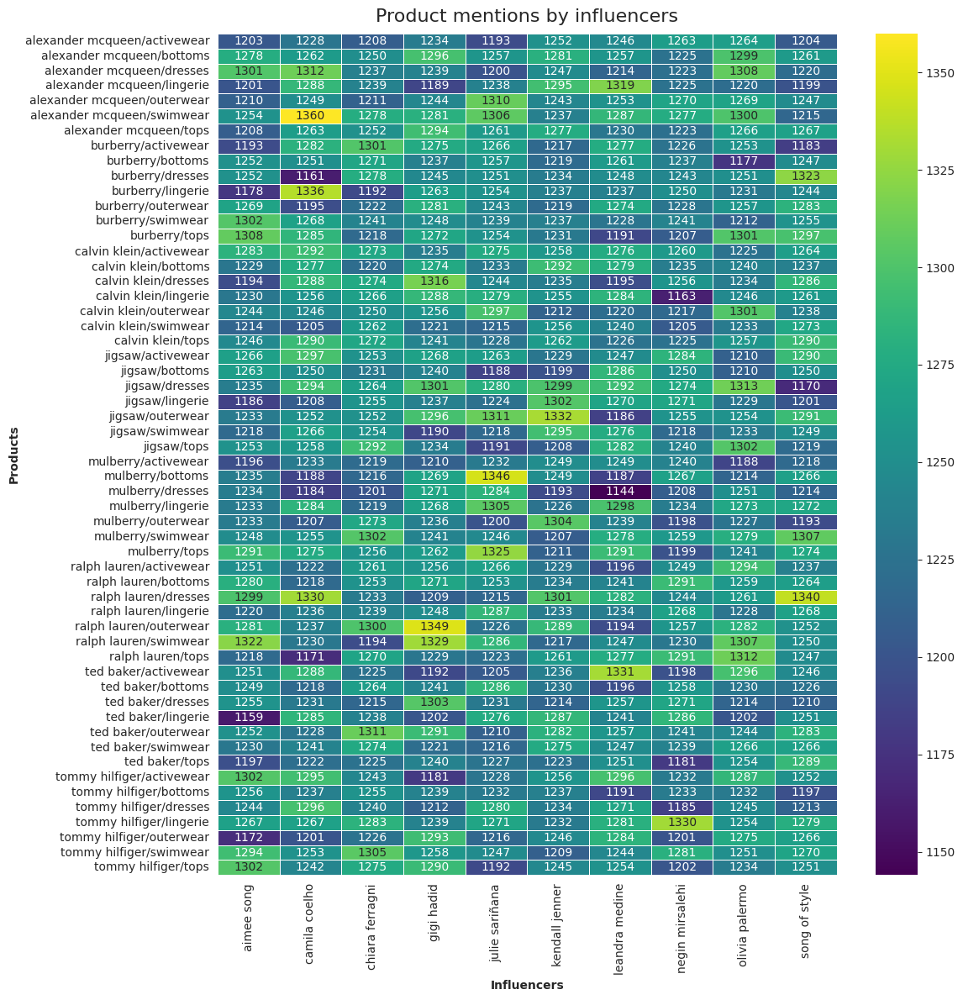

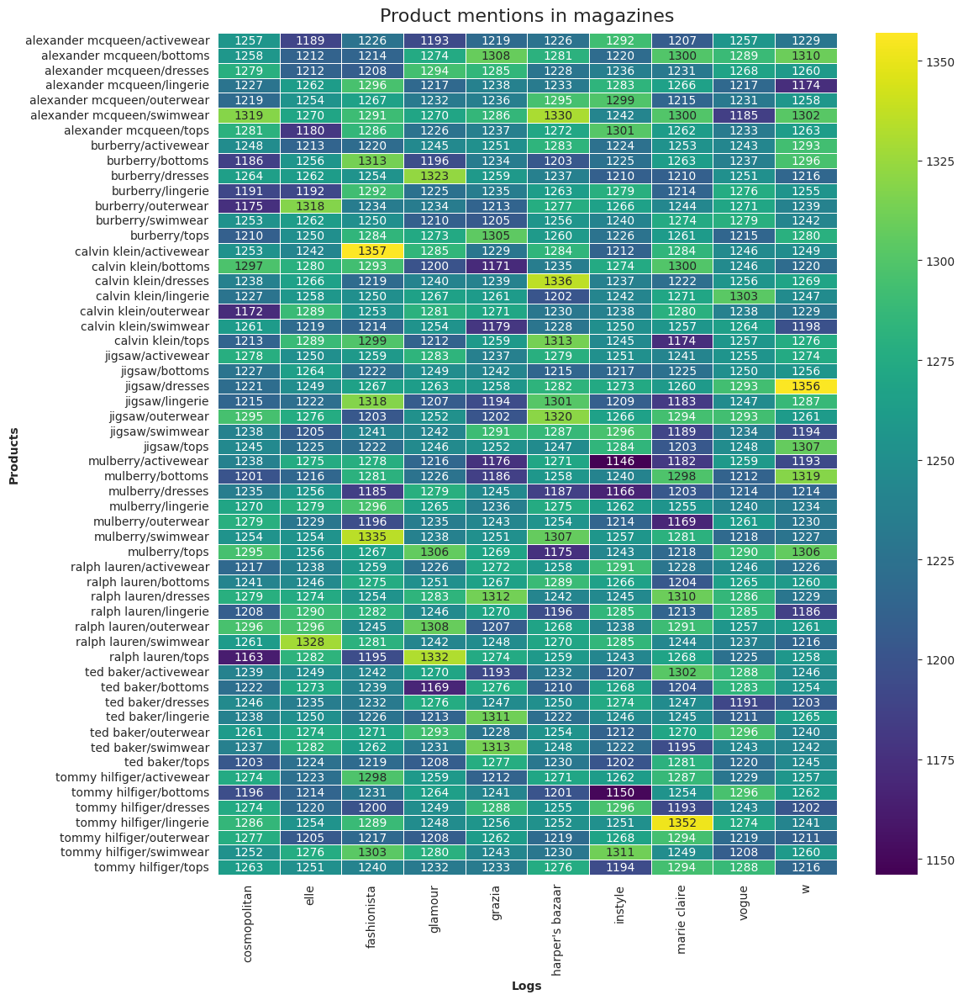

In [ ]:
plt.figure(figsize=(12, 12))
sns.heatmap(influencer_mentions, cmap='viridis', annot=True, fmt='d', linewidths=.5)
plt.title('Product mentions by influencers')
plt.xlabel('Influencers')
plt.ylabel('Products')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 12))
sns.heatmap(magazine_mentions, cmap='viridis', annot=True, fmt='d', linewidths=.5)
plt.title('Product mentions in magazines')
plt.xlabel('Logs')
plt.ylabel('Products')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [ ]:
influencer_colors = ['lightblue', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon','lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'yellow']

In [ ]:
magazine_colors = ['lightblue', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon','lightseagreen', 'lightskyblue', 'lightslategray', 'lightsteelblue', 'yellow']

In [ ]:
num_influencers = len(influencer_mentions.columns)

In [ ]:
num_magazines = len(magazine_mentions.columns)

In [ ]:
bubble_size_multiplier = 4

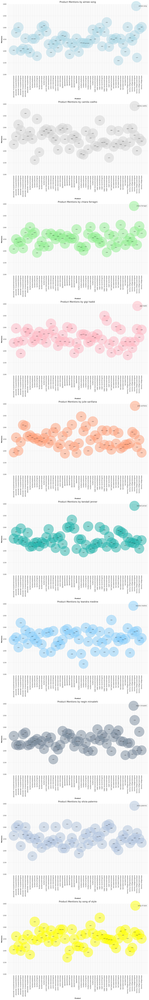

In [ ]:
new_ylim = (1100, 1400)

fig, axs = plt.subplots(num_influencers, 1, figsize=(15, 10*num_influencers), dpi=PLOT_DPI)

for i, influencer in enumerate(influencer_mentions.columns):
    mentions = influencer_mentions[influencer].values

    bubble_text = [f'{mention}' for mention in mentions]

    axs[i].scatter(range(len(mentions)), mentions, s=mentions*bubble_size_multiplier, label=influencer, color=influencer_colors[i % len(influencer_colors)], alpha=0.5)

    for j, txt in enumerate(bubble_text):
        axs[i].annotate(txt, (j, mentions[j]), ha='center', va='center', fontsize=6, color='black')

    axs[i].set_xticks(ticks=range(len(influencer_mentions.index)))
    axs[i].set_xticklabels(labels=influencer_mentions.index, rotation=90)

    axs[i].set_xlabel('Product')
    axs[i].set_ylabel('Mentions')
    axs[i].set_title(f'Product Mentions by {influencer}')

    axs[i].legend()

    axs[i].set_ylim(new_ylim)

plt.tight_layout()
plt.show()

**Highest correlations**:

**Aimee Song and Alexander McQueen Dresses (1312)**: Aimee Song likely regularly mentions Alexander McQueen dresses, which may indicate her preference for the brand and specific product category

**Chiara Ferragni and Alexander McQueen Swimwear (1360)**: Chiara Ferragni is likely strongly associated with the Alexander McQueen swimwear collection, which may indicate her influence in this product category

**Julie Sariñana and Burberry Tops (1308)**: Julie Sariñana is likely to actively discuss and recommend Burberry tops, which may reflect her clothing preferences

**General trends:**

**Burberry Swimwear (1302) and Alexander McQueen Swimwear (1360)**: Both brands show high correlation values with the swimwear category. This may indicate that influencers tend to mention both brands in the context of swimwear, which may be due to the quality or popularity of these products

**Leandra Medine and Jigsaw Outerwear (1332)**: Leandra Medine may be frequently mentioned outerwear by Jigsaw, which may indicate its influence in this product category

**Weak correlations**:

**Gigi Hadid and Mulberry Dresses (1184)**: Here we see a lower correlation value, which may indicate that Gigi Hadid's mentions of Mulberry Dresses are not as frequent or have as much influence on the audience

**Negin Mirsalehi and Calvin Klein Lingerie (1163)**: This is also a weak correlation, which may indicate that Negin Mirsalehi's mentions of Calvin Klein lingerie are not key to this product category

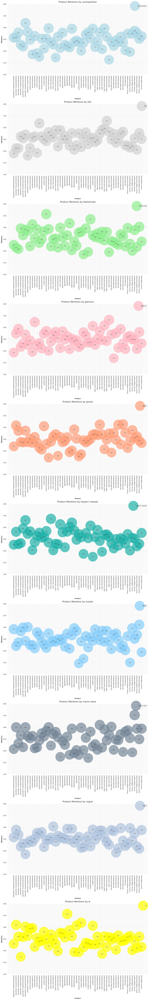

In [ ]:
new_ylim = (1100, 1400)

fig, axs = plt.subplots(num_magazines, 1, figsize=(15, 10*num_magazines), dpi=PLOT_DPI)

for i, magazine in enumerate(magazine_mentions.columns):
    mentions = magazine_mentions[magazine].values

    bubble_text = [f'{mention}' for mention in mentions]

    axs[i].scatter(range(len(mentions)), mentions, s=mentions*bubble_size_multiplier, label=magazine, color=magazine_colors[i % len(magazine_colors)], alpha=0.7)

    for j, txt in enumerate(bubble_text):
        axs[i].annotate(txt, (j, mentions[j]), ha='center', va='center', fontsize=6, color='black')

    axs[i].set_xticks(ticks=range(len(magazine_mentions.index)))
    axs[i].set_xticklabels(labels=magazine_mentions.index, rotation=90)

    axs[i].set_xlabel('Product')
    axs[i].set_ylabel('Mentions')
    axs[i].set_title(f'Product Mentions by {magazine}')

    axs[i].legend()
    axs[i].set_ylim(new_ylim)

plt.tight_layout()
plt.show()


**Highest correlations:**

**Cosmopolitan and Alexander McQueen Swimwear (1319)**: Cosmopolitan appears to frequently mention Alexander McQueen swimwear, which may indicate the magazine's influence in this product category

**Elle and Alexander McQueen Dresses (1294)**: Elle likely covers Alexander McQueen dresses frequently, which may indicate the magazine's influence in this particular category

**Grazia and Burberry Outerwear (1318)**: Grazia may be actively discussing Burberry outerwear, which may reflect the preferences of the magazine's audience

**General trends**:

**InStyle and Calvin Klein Activewear (1357)**: InStyle and Calvin Klein may have a strong connection in the activewear space, which could indicate that InStyle magazine regularly reviews Calvin Klein products in this category

**Vogue and Ralph Lauren Dresses (1312)**: Vogue may have heavy coverage of Ralph Lauren dresses, which may reflect the magazine's influence in this area of fashion

**Weak correlations**:

**Harper's Bazaar and Mulberry Activewear (1,176)**: Here we see a lower correlation value, which may indicate that Harper's Bazaar mentions of Mulberry activewear are not as frequent or do not have as much impact on the audience

**Fashionista and Tommy Hilfiger Bottoms (1,150)**: This is also a weak correlation, which may indicate that Fashionista's mentions of Tommy Hilfiger Bottoms are not key for this product category

In [ ]:
most_mentioned_brands_influencers = {}

for influencer in influencer_mentions.columns:
    most_mentioned_brand = influencer_mentions[influencer].idxmax()
    most_mentioned_brands_influencers[influencer] = most_mentioned_brand

most_mentioned_brands_magazines = {}

for magazine in magazine_mentions.columns:
    most_mentioned_brand = magazine_mentions[magazine].idxmax()
    most_mentioned_brands_magazines[magazine] = most_mentioned_brand

print(f.BOLD + "Most mentioned brands among influencers:" + f.END + CR)
for influencer, brand in most_mentioned_brands_influencers.items():
    print(f"{influencer}: {brand}")

print(CR + f.BOLD + "The most mentioned brands among magazines:" + f.END + CR)
for magazine, brand in most_mentioned_brands_magazines.items():
    print(f"{magazine}: {brand}")

Most mentioned brands among influencers:

aimee song: ralph lauren/swimwear
camila coelho: alexander mcqueen/swimwear
chiara ferragni: ted baker/outerwear
gigi hadid: ralph lauren/outerwear
julie sariñana: mulberry/bottoms
kendall jenner: jigsaw/outerwear
leandra medine: ted baker/activewear
negin mirsalehi: tommy hilfiger/lingerie
olivia palermo: jigsaw/dresses
song of style: ralph lauren/dresses

The most mentioned brands among magazines:

cosmopolitan: alexander mcqueen/swimwear
elle: ralph lauren/swimwear
fashionista: calvin klein/activewear
glamour: ralph lauren/tops
grazia: ted baker/swimwear
harper's bazaar: calvin klein/dresses
instyle: tommy hilfiger/swimwear
marie claire: tommy hilfiger/lingerie
vogue: calvin klein/lingerie
w: jigsaw/dresses


In [ ]:
influencers = list(most_mentioned_brands_influencers.keys())
brands_influencers = list(most_mentioned_brands_influencers.values())

magazines = list(most_mentioned_brands_magazines.keys())
brands_magazines = list(most_mentioned_brands_magazines.values())

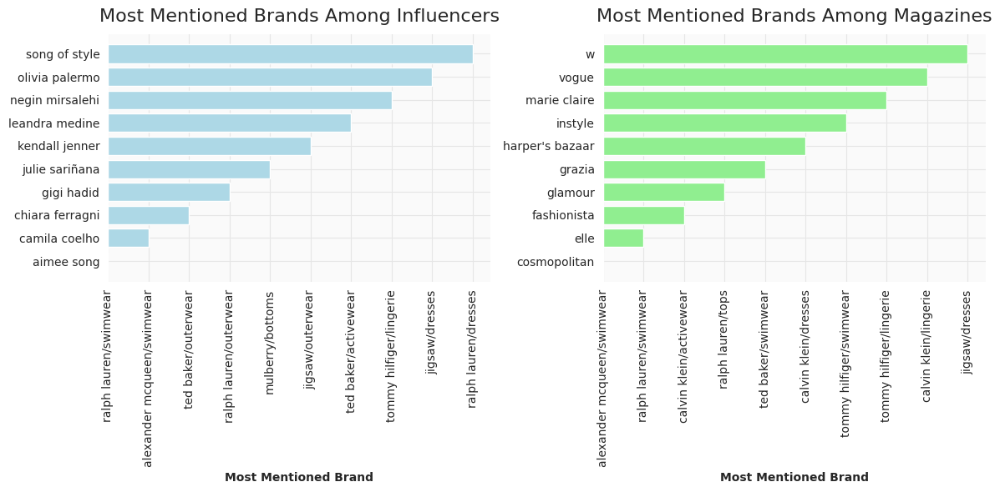

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.barh(influencers, brands_influencers, color='lightblue')
plt.xlabel('Most Mentioned Brand')
plt.title('Most Mentioned Brands Among Influencers')
plt.xticks(rotation=90)

plt.subplot(1, 2, 2)
plt.barh(magazines, brands_magazines, color='lightgreen')
plt.xlabel('Most Mentioned Brand')
plt.title('Most Mentioned Brands Among Magazines')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

Researching product categories and analyzing popular categories in the dataset, as well as their shares in total sales, can give us valuable information about which product categories are most in demand and how they affect overall sales

**Identification of the most popular product categories:** By analyzing popular product categories, we can determine which types of products are most in demand among consumers

**Understanding demand for specific categories:** We can see which product categories are attracting the most interest from buyers, which will help companies tailor their marketing strategies and offerings

**Assessing the contribution of each category to total sales:** Analyzing the shares of total sales will help us understand what share of the company's revenue comes from each product category. This will allow you to identify the key and most profitable business segments

**Identification of trends and changes over time:** Conducting such analysis over different time periods will allow you to track changes in consumer preferences and market trends.

In [ ]:
category_counts = df['Category'].value_counts()
category_counts_df = category_counts.reset_index()
category_counts_df.columns = ['Category', 'Count']

category_counts_df

,Category,Count
0,swimwear,100328
1,outerwear,100076
2,tops,100041
3,dresses,99950
4,lingerie,99949
5,activewear,99751
6,bottoms,99666


In [ ]:
category_sales = df.groupby('Category')['Price'].sum().reset_index()
category_sales['Sales (%)'] = (category_sales['Price'] / df['Price'].sum()) * 100
category_sales = category_sales.sort_values(by='Category')

category_sales

,Category,Price,Sales (%)
0,activewear,5488218.71,14.26
1,bottoms,5487520.06,14.26
2,dresses,5487528.19,14.26
3,lingerie,5502514.55,14.30
4,outerwear,5499852.48,14.29
5,swimwear,5525093.66,14.35
6,tops,5500400.20,14.29


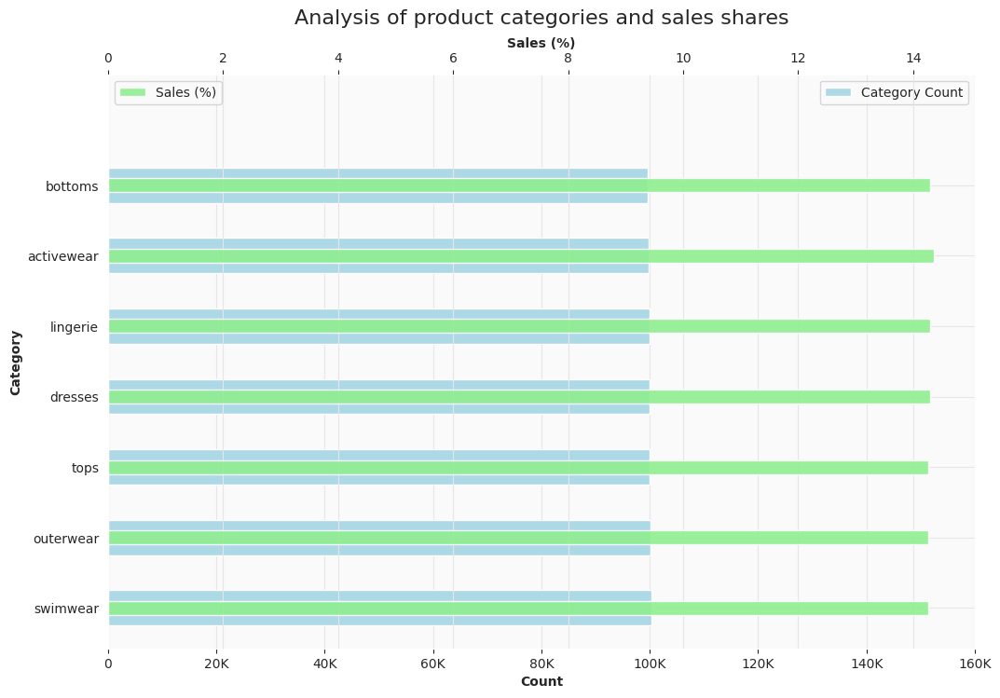

In [ ]:
fig, ax1 = plt.subplots(figsize=(12, 8))

color = 'lightblue'
ax1.barh(category_counts_df['Category'], category_counts_df['Count'], color=color, label='Category Count', alpha = 1,height=0.5)
ax1.set_xlabel('Count')
ax1.set_ylabel('Category')

ax2 = ax1.twiny()

color = 'lightgreen'
ax2.barh(category_sales.index, category_sales['Sales (%)'], color=color, label='Sales (%)',alpha = 0.9,height=0.2)
ax2.set_xlabel('Sales (%)')

ax1.set_ylim(ax1.get_ylim()[0], ax1.get_ylim()[1] + 0.5)
ax2.set_ylim(ax2.get_ylim()[0], ax2.get_ylim()[1] + 0.5)

ax1.set_xticks([0, 20000, 40000, 60000, 80000, 100000, 120000,140000,160000])
ax1.set_xticklabels(['0', '20K', '40K', '60K', '80K', '100K', '120K', '140K','160K'])

ax1.legend(loc='upper right')
ax2.legend(loc='upper left')

plt.title('Analysis of product categories and sales shares')

plt.show()

**Brand assessment:** identifying the most popular brands and their impact on demand - will help us understand which brands are most popular among consumers and how their popularity affects the demand for goods. This will allow us to identify trends and consumer brand preferences and understand which brands have the greatest influence on product demand

Specific aspects that we can identify through this step include:

**Top Brands:** We can identify the top brands among all that appear most frequently in our dataset. This will allow us to understand which brands are most preferred by consumers

**Brand Impact on Demand:** By analyzing brand popularity and sales data, we can identify which brands have the greatest impact on sales. This will help us understand how important brand reputation is to consumers and how it influences their purchasing behavior

**Consumer Trends and Preferences:** Analyzing popular brands will also help us to identify consumer trends and preferences regarding brands. For example, we can determine whether there is a preference for certain brands based on season, product type, or other factors

We can also explore how other factors such as sizes, colors and seasons affect the popularity of brands and their impact on demand. This will help us gain a better understanding of how brands interact with other aspects of products and consumer behavior

In [ ]:
#Analysis of popular seasons for each brand
season_counts = df.groupby(['Brand', 'Season']).size().unstack().fillna(0)
popular_seasons = season_counts.idxmax(axis=1)
print(popular_seasons)

Brand
alexander mcqueen         spring
burberry                    fall
calvin klein              winter
jigsaw                      fall
mulberry                    fall
ralph lauren              spring
ted baker                   fall
tommy hilfiger       fall/winter
dtype: object


In [ ]:
#Analysis of popular sizes for each brand
size_counts = df.groupby(['Brand', 'Available Sizes']).size().unstack().fillna(0)
popular_sizes = size_counts.idxmax(axis=1)
print(popular_sizes)

Brand
alexander mcqueen     s
burberry              l
calvin klein          l
jigsaw                m
mulberry              s
ralph lauren          s
ted baker             s
tommy hilfiger       xl
dtype: object


In [ ]:
# Analysis of popular colors for each brand¶
color_counts = df.groupby(['Brand', 'Color']).size().unstack().fillna(0)
popular_colors = color_counts.idxmax(axis=1)
print(popular_colors)

Brand
alexander mcqueen      red
burberry             green
calvin klein         black
jigsaw                blue
mulberry               red
ralph lauren          blue
ted baker            green
tommy hilfiger       green
dtype: object


In [ ]:
brands = ['alexander mcqueen', 'burberry', 'calvin klein', 'jigsaw', 'mulberry', 'ralph lauren', 'ted baker', 'tommy hilfiger']
popular_seasons = ['spring', 'fall', 'winter', 'fall', 'fall', 'spring', 'fall', 'fall/winter']
popular_sizes = ['s', 'l', 'l', 'm', 's', 's', 's', 'xl']
popular_colors = ['red', 'green', 'black', 'blue', 'red', 'blue', 'green', 'green']

In [ ]:
fig = go.Figure()

fig.add_trace(go.Bar(
    y=brands,
    x=popular_seasons,
    orientation='h',
    name='Popular Seasons',
    marker=dict(color='lightblue'),
    hoverinfo='x'
))

fig.add_trace(go.Bar(
    y=brands,
    x=popular_sizes,
    orientation='h',
    name='Popular Sizes',
    marker=dict(color='lightpink'),
    hoverinfo='x'
))

fig.add_trace(go.Bar(
    y=brands,
    x=popular_colors,
    orientation='h',
    name='Popular Colors',
    marker=dict(color='lightgray'),
    hoverinfo='x'
))

fig.update_layout(
    title='Analysis of Popular Seasons, Sizes, and Colors for Each Brand',
    xaxis_title='Category',
    yaxis_title='Brand',
    barmode='stack',
    legend=dict(title='Analysis'),
    yaxis=dict(tickfont=dict(size=9)),
    height=600,
    width=1200
 )

print(f.BOLD + "The most popular brands:"+ f.END + CR)
print(brand_counts)
print(CR)

print(f.BOLD + "The most popular seasons for each brand:"+ f.END + CR)
print(popular_seasons)
print(CR)

print(f.BOLD + "The most popular size for each brand:" + f.END + CR)
print(popular_sizes)
print(CR)

print(f.BOLD + "Most popular color for each brand:" + f.END + CR)
print(popular_colors)
print(CR)


fig.show()

The most popular brands:

Brand
ralph lauren         87978
alexander mcqueen    87717
jigsaw               87637
calvin klein         87549
tommy hilfiger       87483
burberry             87296
ted baker            87077
mulberry             87024
Name: count, dtype: int64


The most popular seasons for each brand:

['spring', 'fall', 'winter', 'fall', 'fall', 'spring', 'fall', 'fall/winter']


The most popular size for each brand:

['s', 'l', 'l', 'm', 's', 's', 's', 'xl']


Most popular color for each brand:

['red', 'green', 'black', 'blue', 'red', 'blue', 'green', 'green']




The visualization provides information about the most popular seasons, sizes and colors for each brand

**How to read this chart**:

Each graphic bar represents a different brand
There are three columns for each brand: one for popular seasons, one for popular sizes and one for popular colors
The length of each column shows how popular the corresponding indicator (season, size or color) is for that brand
The color of each column indicates the corresponding attribute: blue for seasons, green for sizes, and coral for flowers

This way, you can quickly assess which seasons, sizes and colors are the most popular for each brand by comparing their relative column lengths and colors

From the data obtained we can draw the following conclusions

**Popular brands**: Among the presented brands, the most popular among buyers are “Ralph Lauren”, “Alexander McQueen” and “Jigsaw”, which have the largest number of sales.

**Popular Seasons for Each Brand**: Brands have different seasonal preferences. For example, Alexander McQueen and Ralph Lauren are most popular in the spring, while Burberry and Tommy Hilfiger are most popular in the fall and winter. Which is quite easily explained by the range of these brands.

**Popular sizes for each brand**: Brands also differ in size selection. For example, most Alexander McQueen customers choose size S, while Tommy Hilfiger's most popular size is XL. Here it is worth thinking about the size grids that are presented in the brand.

**Popular colors for each brand**: Just like with sizes, different brands have their own color preferences. For example, "Alexander McQueen" and "Mulberry" are the most popular colors among shoppers in red, while "Burberry" and "Ted Baker" prefer green. An important note, but nevertheless, the statistics here are influenced by the collection and the colors presented in it.

These findings can help us better understand the customer preferences of these major fashion brands, and tailor our marketing and production strategies to suit them. This can also be useful information for forming the assortment of retail stores and online platforms.

**Style Characteristics Analysis:** - Identifying key style characteristics that influence customer preferences. Let's try to understand which style is more common in the brand? What color is most common in style? What size is the most common style?

In [ ]:
# Determine the most common style
most_common_style = df['Style Attributes'].value_counts().idxmax()
print(f.BOLD + "Most common style:" + f.END, most_common_style+CR)

# Determine the most common color in a style
color_counts = df.groupby('Style Attributes')['Color'].value_counts().unstack().fillna(0)
most_common_color_per_style = color_counts.idxmax()
print(print(f.BOLD + "Most common style color:"+ f.END + CR))
print(most_common_color_per_style, CR)

# Determine the most common size in a style
size_counts = df.groupby('Style Attributes')['Available Sizes'].value_counts().unstack().fillna(0)
most_common_size_per_style = size_counts.idxmax()
print(f.BOLD + "The most common size in style:" + f.END + CR)
print(most_common_size_per_style, CR)

# Determining the most popular style for each brand
most_common_style_per_brand = df.groupby('Brand')['Style Attributes'].agg(lambda x: x.value_counts().idxmax())
print(f.BOLD + "The most popular style for each brand:" + f.END + CR)
print(most_common_style_per_brand)

Most common style: formal

Most common style color:

None
Color
black    streetwear
blue         casual
green        formal
red          casual
dtype: object 

The most common size in style:

Available Sizes
l         preppy
m     streetwear
s         casual
xl       vintage
dtype: object 

The most popular style for each brand:

Brand
alexander mcqueen       vintage
burberry                 casual
calvin klein         minimalist
jigsaw                glamorous
mulberry                 formal
ralph lauren          glamorous
ted baker               vintage
tommy hilfiger           preppy
Name: Style Attributes, dtype: object


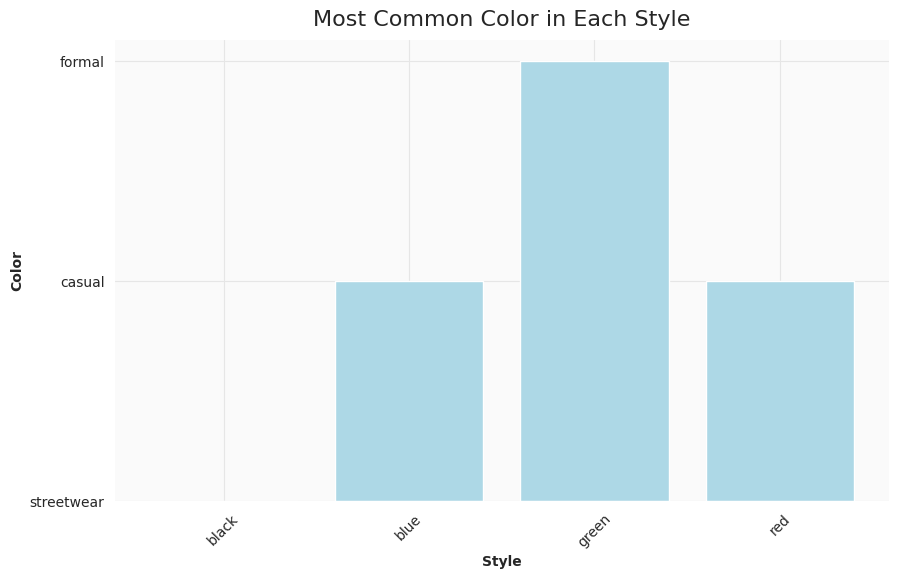

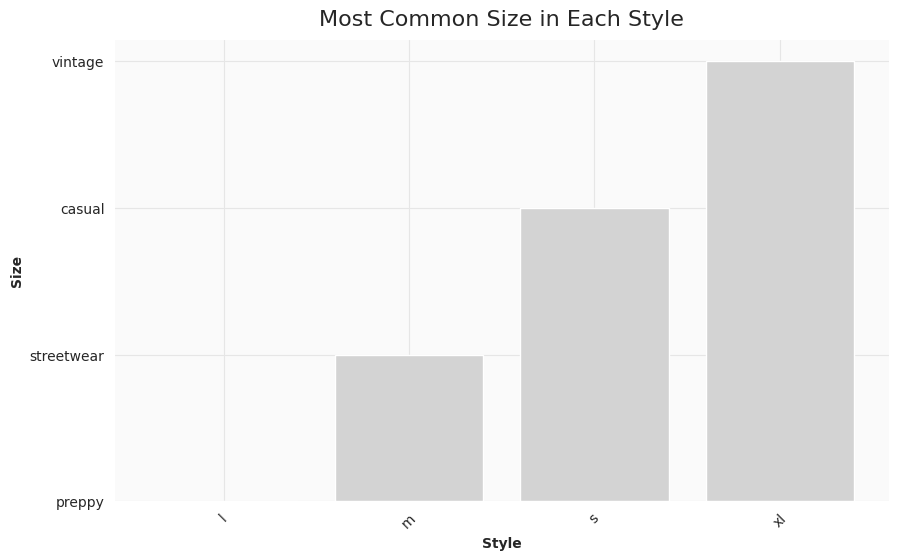

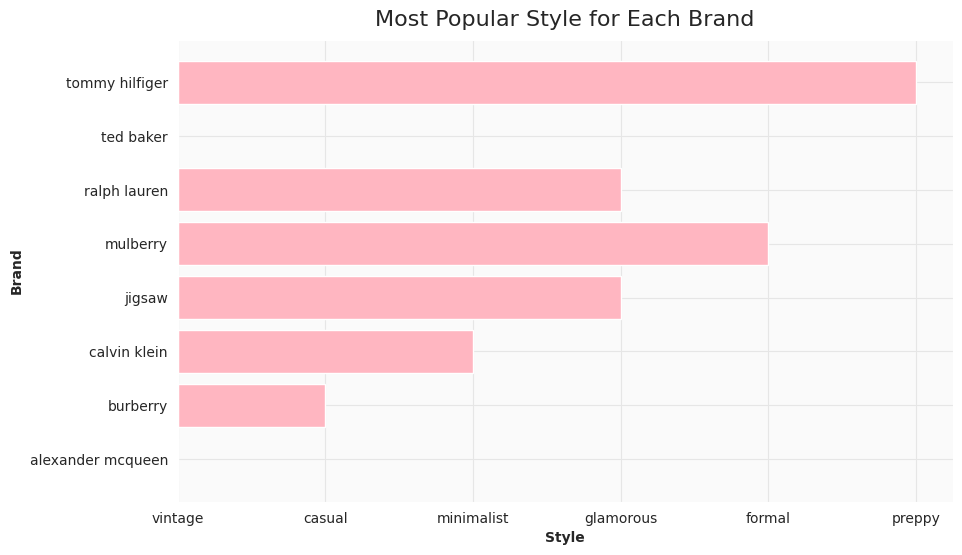

In [ ]:
plt.figure(figsize=(10, 6))
styles = most_common_color_per_style.index
colors = most_common_color_per_style.values
plt.bar(styles, colors, color='lightblue')
plt.xlabel('Style')
plt.ylabel('Color')
plt.title('Most Common Color in Each Style')
plt.xticks(rotation=45)


plt.figure(figsize=(10, 6))
for style, size in most_common_size_per_style.items():
    plt.bar(style, size, color='lightgray')
plt.xlabel('Style')
plt.ylabel('Size')
plt.title('Most Common Size in Each Style')
plt.xticks(rotation=45)

plt.figure(figsize=(10, 6))
brands = most_common_style_per_brand.index
styles = most_common_style_per_brand.values
plt.barh(brands, styles, color='lightpink')
plt.xlabel('Style')
plt.ylabel('Brand')
plt.title('Most Popular Style for Each Brand')
plt.show()
plt.show()

In [ ]:
# Identifying the five most popular colors for each style
top5_styles_per_color = df.groupby('Style Attributes')['Color'].apply(lambda x: x.value_counts().nlargest(5).index.tolist())
print(f.BOLD + "Five most popular colors for each style:" + f.END + CR)
print(top5_styles_per_color, CR)

# Identifying the five most popular sizes for each style
top5_sizes_per_style = df.groupby('Style Attributes')['Available Sizes'].apply(lambda x: x.value_counts().nlargest(5).index.tolist())
print(f.BOLD + "Five most popular sizes for each style:" + f.END + CR)
print(top5_sizes_per_style, CR)

# Identifying the five most popular styles for each brand
top5_styles_per_brand = df.groupby('Brand')['Style Attributes'].apply(lambda x: x.value_counts().nlargest(5).index.tolist())
print(f.BOLD + "Five most popular styles for each brand:" + f.END + CR)
print(top5_styles_per_brand, CR)

Five most popular colors for each style:

Style Attributes
bohemian      [red, blue, green, black]
casual        [blue, red, green, black]
edgy          [red, blue, black, green]
formal        [green, black, red, blue]
glamorous     [green, black, blue, red]
minimalist    [blue, red, black, green]
preppy        [blue, black, green, red]
sporty        [green, black, red, blue]
streetwear    [black, red, blue, green]
vintage       [green, red, blue, black]
Name: Color, dtype: object 

Five most popular sizes for each style:

Style Attributes
bohemian      [s, xl, m, l]
casual        [s, xl, l, m]
edgy          [s, l, xl, m]
formal        [s, l, m, xl]
glamorous     [s, xl, m, l]
minimalist    [s, m, l, xl]
preppy        [l, s, xl, m]
sporty        [l, xl, m, s]
streetwear    [xl, m, s, l]
vintage       [xl, l, m, s]
Name: Available Sizes, dtype: object 

Five most popular styles for each brand:

Brand
alexander mcqueen         [vintage, sporty, preppy, streetwear, edgy]
burberry         

In [ ]:
# Group data by season and style, and then count the number of each style in each season
styles_per_season = df.groupby(['Season', 'Style Attributes']).size().unstack(fill_value=0)
print(f.BOLD + "Styles in every season:" + f.END + CR)
print(styles_per_season)

Styles in every season:

Style Attributes  bohemian  casual  edgy   formal  glamorous  minimalist  \
Season                                                                     
fall              11636     11920   11622  11639   11723      11742        
fall/winter       11884     11655   11730  11671   11798      11539        
spring            11675     11565   11876  11548   11530      11854        
spring/summer     11689     11407   11536  11911   11414      11602        
summer            11549     11652   11583  11617   11492      11601        
winter            11697     11665   11603  11791   11738      11537        

Style Attributes  preppy  sporty  streetwear  vintage  
Season                                                 
fall              11539   11625   11784       11813    
fall/winter       11688   11781   11607       11632    
spring            11652   11755   11679       11776    
spring/summer     11653   11556   11914       11564    
summer            11633   1161

**Market sentiment analysis - includes:** studying customer reviews and comments on social networks; assessing the level of customer satisfaction using ratings and feedback; analysis of purchase history and determination of periods of greatest sales; study ratings and reviews; analyze the impact of ratings and the number of reviews on sales; assess the level of customer satisfaction; analyze customer feedback to identify key problems and product strengths.

In [ ]:
# Let's study customer reviews and comments on social networks

reviews = list(df['Customer Reviews'])
comments = list(df['Social Media Comments'])

print("Customer Reviews:", reviews[:5])
print("Social Media Comments:", comments[:5])

Customer Reviews: ['negative', 'neutral', 'positive', 'positive', 'positive']
Social Media Comments: ['neutral', 'other', 'mixed', 'negative', 'other']


In [ ]:
sia = SentimentIntensityAnalyzer()

df['Sentiment'] = df['feedback'].apply(lambda x: sia.polarity_scores(x)['compound'])

print(df[['feedback', 'Sentiment']])

       feedback   Sentiment
1          other  0.00     
3          other  0.00     
4       positive  0.56     
5          other  0.00     
6       negative -0.57     
...          ...        ...
999989   neutral  0.00     
999990  negative -0.57     
999996   neutral  0.00     
999997   unknown  0.00     
999998     other  0.00     

[699761 rows x 2 columns]


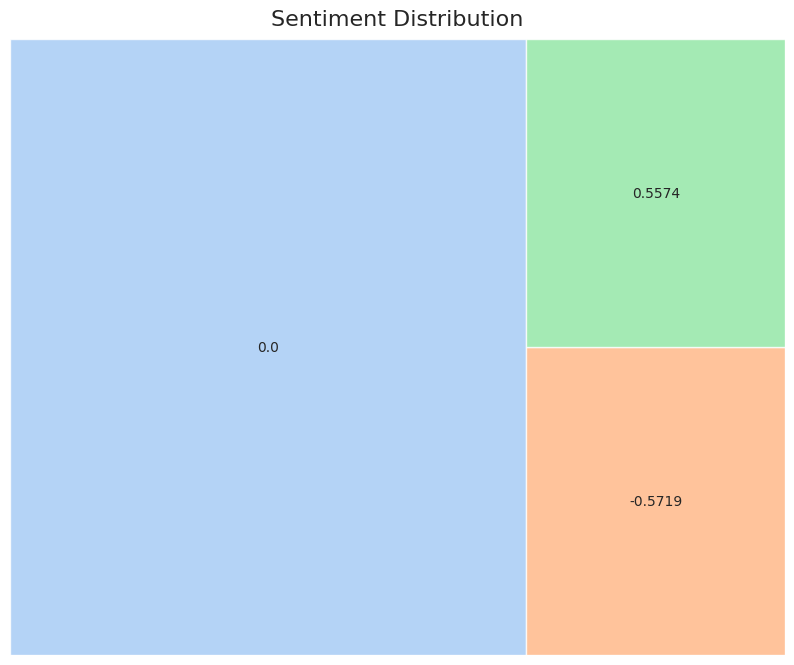

In [ ]:
plt.figure(figsize=(10, 8))
squarify.plot(sizes=df['Sentiment'].value_counts(), label=df['Sentiment'].value_counts().index,color=sns.color_palette('pastel'),
              alpha=0.8)
plt.axis('off')
plt.title('Sentiment Distribution')
plt.show()

In [ ]:
average_sentiment = df['Sentiment'].mean()
print(f.BOLD + "Average feedback sentiment:" + f.END, average_sentiment)

Average feedback sentiment: -0.0025521933917437454


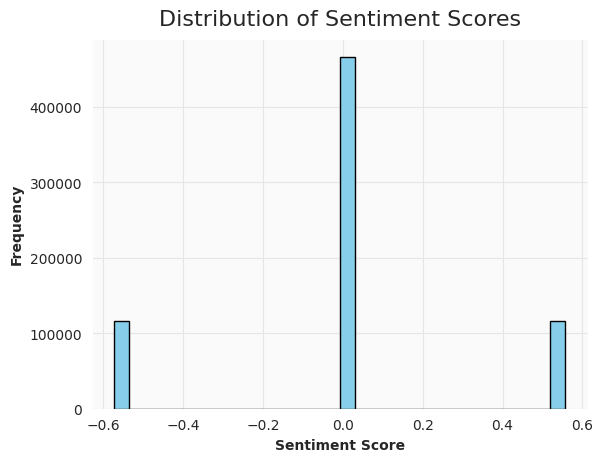

In [ ]:
plt.hist(df['Sentiment'], bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of Sentiment Scores')
plt.show()

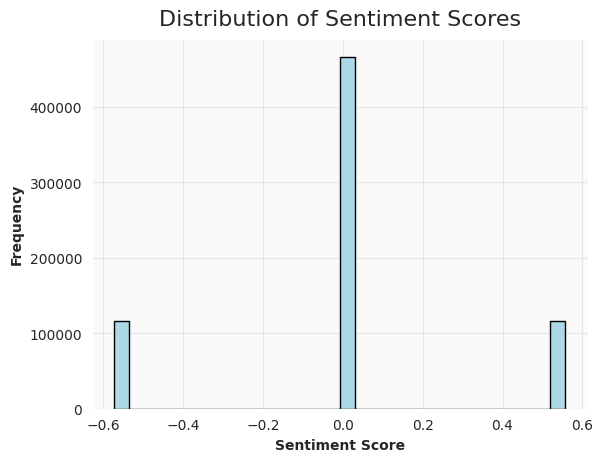

In [ ]:
plt.hist(df['Sentiment'], bins=30, color='lightblue', edgecolor='black')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of Sentiment Scores')
plt.show()

In [ ]:
sentiment_scores = []

for review in reviews:
    sentiment_score = sia.polarity_scores(review)
    sentiment_scores.append(sentiment_score['compound'])

print("Number of reviews:", len(sentiment_scores))
print("Average sentiment score:", sum(sentiment_scores) / len(sentiment_scores))
print("Minimum sentiment score:", min(sentiment_scores))
print("Maximum sentiment score:", max(sentiment_scores))

Number of reviews: 699761
Average sentiment score: -0.002639965788320128
Minimum sentiment score: -0.5719
Maximum sentiment score: 0.5574


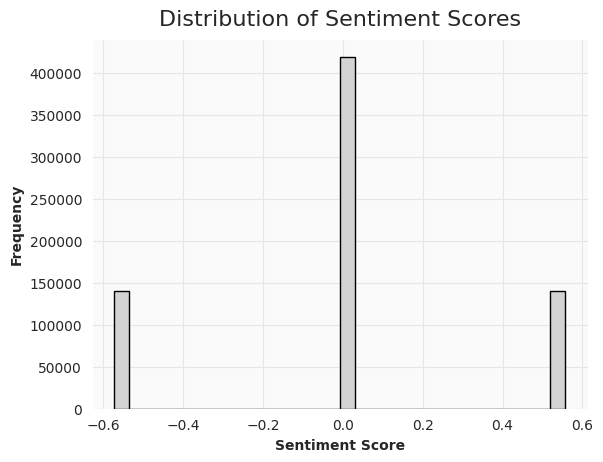

In [ ]:
plt.hist(sentiment_scores, bins=30, color='lightgray', edgecolor='black')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of Sentiment Scores')
plt.show()

In [ ]:
# Evaluate the level of customer satisfaction using ratings and feedback
average_rating = df['Rating'].mean()
print(f.BOLD + "Average Rating:" + f.END, average_rating)

Average Rating: 2.9977945011040092


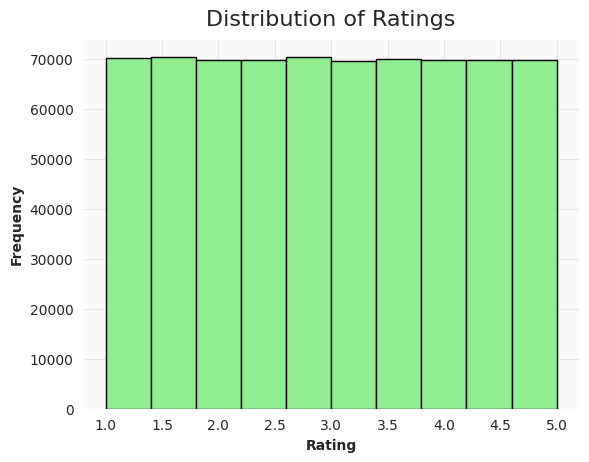

In [ ]:
plt.hist(df['Rating'], bins=10, color='lightgreen', edgecolor='black')
plt.xlabel('Rating')
plt.ylabel('Frequency')
plt.title('Distribution of Ratings')
plt.show()

In [ ]:
unique = df['Time Period Highest Purchase'].unique()
unique

array(['weekend', 'daytime', 'holiday', 'nighttime', 'evening'],
      dtype=object)

In [ ]:
# Let's analyze purchase history and determine the periods of greatest sales

sales_by_time = df.groupby(['Season', 'Time Period Highest Purchase'])['Review Count'].sum().reset_index()

In [ ]:
fig = px.line(sales_by_time, x='Time Period Highest Purchase', y='Review Count', color='Season',
              title='Total Sales by Time Period and Season',
              labels={'Review Count': 'Total Sales (Review Count)', 'Time Period Highest Purchase': 'Time Period'},
              color_discrete_sequence=['lightblue', 'lightgray', 'lightgreen', 'lightpink', 'lightsalmon','lightseagreen',
                                       'lightskyblue', 'lightslategray', 'lightsteelblue', 'yellow'],
              width=1200, height=800)

fig.show()

In [ ]:
# Let's study ratings and reviews: analysis of commercial ratings and the number of reviews about the sale

X = df[['Rating', 'Review Count']]
y = df['Price']

X = sm.add_constant(X)
model = sm.OLS(y, X).fit()

print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.6155
Date:                Mon, 20 Jan 2025   Prob (F-statistic):              0.540
Time:                        07:59:48   Log-Likelihood:            -3.2720e+06
No. Observations:              699761   AIC:                         6.544e+06
Df Residuals:                  699758   BIC:                         6.544e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           54.9103      0.102    540.022   

The results of regression analysis show that the model does not explain the variation in Price using Rating and Review Count:

1. The **coefficient of determination** (R-squared) is 0.0, which means that the model does not explain the variation in the dependent variable.

2. The **slope coefficients** (coef) for rating and number of reviews are close to zero and statistically insignificant (p-value > 0.05), indicating that these factors do not influence the price.

3. The **F-test statistic** (F-statistic) also does not allow us to reject the null hypothesis that all coefficients are equal to zero.

These results suggest that rating and number of reviews are likely not significant predictors of product price in this context.
It is possible that other factors not taken into account in this model have a greater impact on the price of a product.

# Buyer Profile

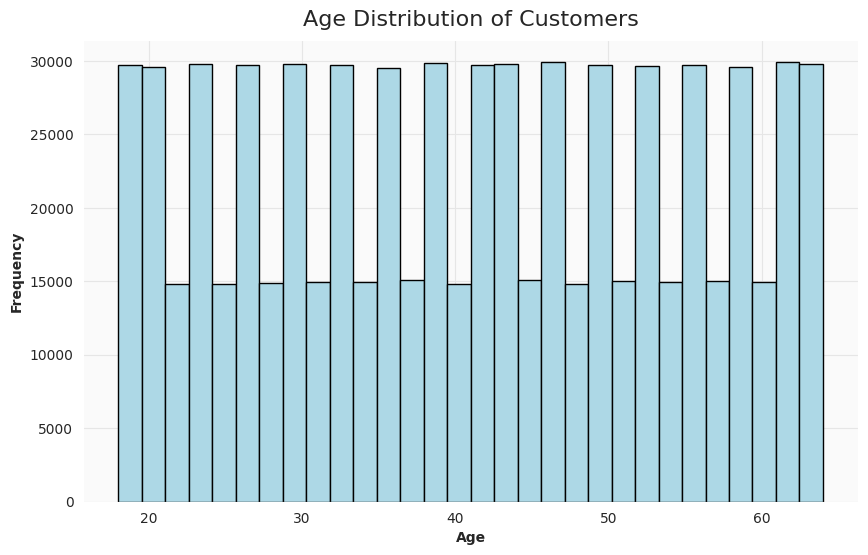

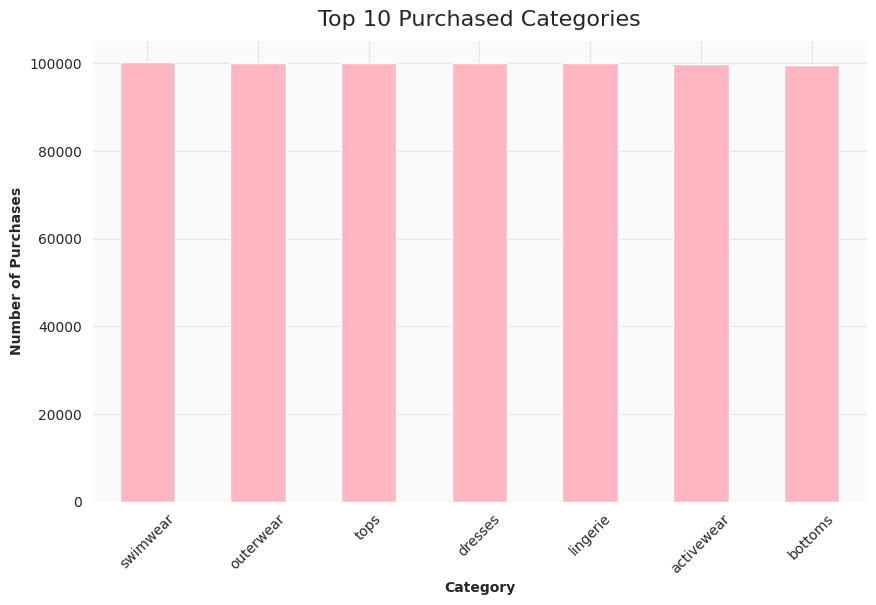

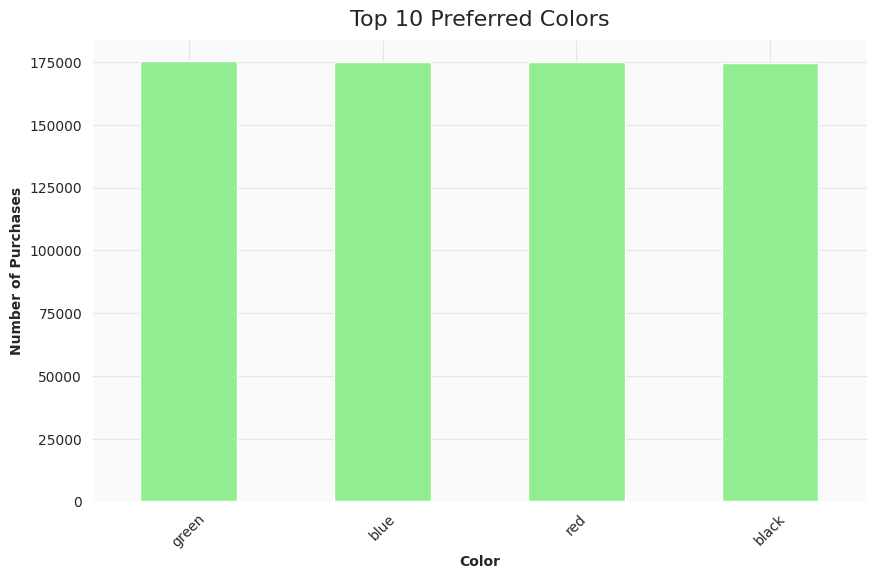

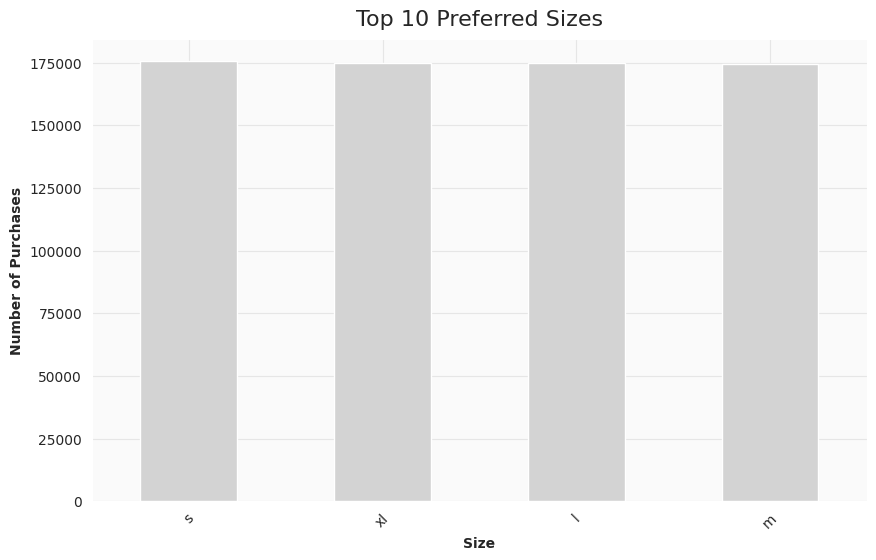

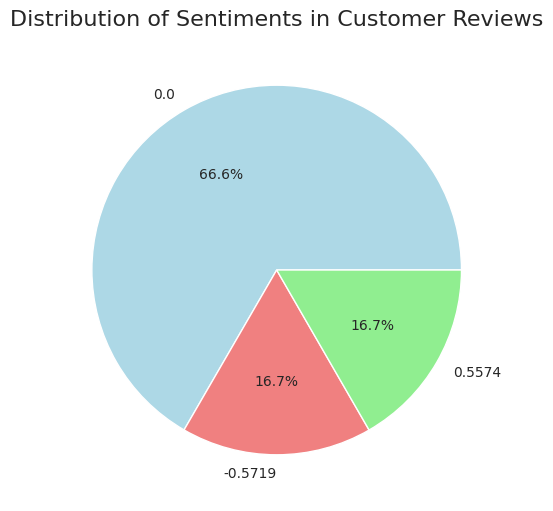

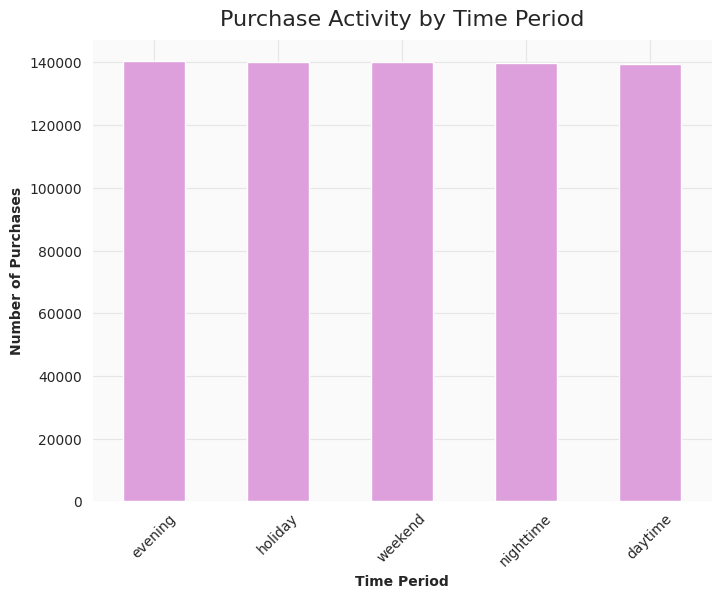

In [ ]:
# Analysis of the buyer's age
plt.figure(figsize=(10, 6))
plt.hist(df['Age'], bins=30, color='lightblue', edgecolor='black')
plt.title('Age Distribution of Customers')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

# Frequently purchased items
top_categories = df['Category'].value_counts().head(10)
plt.figure(figsize=(10, 6))
top_categories.plot(kind='bar', color='lightpink')
plt.title('Top 10 Purchased Categories')
plt.xlabel('Category')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45)
plt.show()

# Preferred colors
top_colors = df['Color'].value_counts().head(10)
plt.figure(figsize=(10, 6))
top_colors.plot(kind='bar', color='lightgreen')
plt.title('Top 10 Preferred Colors')
plt.xlabel('Color')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45)
plt.show()

# Preferred sizes
top_sizes = df['Available Sizes'].value_counts().head(10)
plt.figure(figsize=(10, 6))
top_sizes.plot(kind='bar', color='lightgray')
plt.title('Top 10 Preferred Sizes')
plt.xlabel('Size')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45)
plt.show()

# Reviews
sentiment_counts = df['Sentiment'].value_counts()
plt.figure(figsize=(6, 6))
sentiment_counts.plot(kind='pie', autopct='%1.1f%%', colors=['lightblue', 'lightcoral', 'lightgreen'])
plt.title('Distribution of Sentiments in Customer Reviews')
plt.ylabel('')
plt.show()

# Activity in different periods
purchase_periods = df['Time Period Highest Purchase'].value_counts()
plt.figure(figsize=(8, 6))
purchase_periods.plot(kind='bar', color='plum')
plt.title('Purchase Activity by Time Period')
plt.xlabel('Time Period')
plt.ylabel('Number of Purchases')
plt.xticks(rotation=45)
plt.show()

In [ ]:
df.head(1)

,Price,Brand,Category,Description,Rating,Review Count,Style Attributes,Total Sizes,Available Sizes,Color,Purchase History,Age,Fashion Magazines,Fashion Influencers,Season,Time Period Highest Purchase,Customer Reviews,Social Media Comments,feedback,Product,Sentiment
1,52.34,ted baker,tops,not good,1.04,57.00,vintage,"m, l, xl",xl,black,above average,61.00,glamour,leandra medine,winter,weekend,negative,neutral,other,ted baker/tops,0.00
